# Comparison TOPAZ4-ML, ICESat1, Envisat monthly mean

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import netCDF4 as nc4
import xarray as xr
import pandas as pd
from mpl_toolkits.basemap import Basemap

from src.feature_extraction import monthly_mean_TP as mm
from src.utils import modif_plot
from src.utils import save_name

In [2]:
from importlib import reload

In [3]:
reload(mm)

<module 'src.feature_extraction.monthly_mean_TP' from '/users/edelleo1/tardis/tardis-ml/src/feature_extraction/monthly_mean_TP.py'>

# Import TOPAZ4-ML monthly mean

In [4]:
# ifolder = '/scratch/project_465000269/edelleo1/Leo/results/lstm_231212-183758/ml/'
# ifolder = '/scratch/project_465000269/edelleo1/Leo/results/lstm_240405-180331/ml/'
ifolder = '/scratch/project_465000269/edelleo1/Leo/results/lstm_240523-170100/ml/'  # best of the best (?)
ifolder = '/scratch/project_465000269/edelleo1/Leo/results/lstm_240524-173523/ml/'  # best of the best - N24



ifile = 'sit_gLSTM3_bk_1998_2011_01.nc'
# ifile = 'sit_gLSTM3_bk_1999_2010_01.nc'


nc = nc4.Dataset(f'{ifolder}{ifile}', mode='r')

X = xr.open_dataset(xr.backends.NetCDF4DataStore(nc))['sit_ml']
chrono = pd.DataFrame({'date':pd.to_datetime(X['time'].to_numpy())})

In [5]:
# Need to import SIC to remove SIC < 0.15%

In [6]:
sit_fr = xr.open_dataset(xr.backends.NetCDF4DataStore(nc))['sit_na']

In [7]:
# import
ifolder = '/scratch/project_465000269/edelleo1/Leo/results/pca_i100-550_j150-629/'
ifile = 'siconc_TOPAZ4b23_1999_2010_FreeRun.nc'
nc = nc4.Dataset(f'{ifolder}{ifile}', mode='r')
sic_fr = xr.open_dataset(xr.backends.NetCDF4DataStore(nc))['siconc']

In [8]:
# remove SIC
# sit_ml = X.where((sic_na>0.15) | (sic_na.isnull()), 0)
sit_ml = X.where((sic_fr>0.15))

In [9]:
sit_mm = mm.compute_mm(sit_ml)

## Import TOPAZ4-FR

In [10]:
sit_fr = sit_fr.where((sic_fr>0.15))

In [11]:
sit_mm_fr = mm.compute_mm(sit_fr)

In [12]:
chrono_mm = pd.DataFrame({'date':pd.to_datetime(sit_mm['time'].to_numpy())})

## Import TOPAZ4-BL

In [13]:
# do a .nc file with BL correction so no need to compute each time

In [14]:
ifolder = '/scratch/project_465000269/edelleo1/Leo/TP4_ML/'
ifile = 'sit_bl_1999_2010.nc'
ifile = 'sit_bl_2000_2011_adjSIC.nc'

In [15]:
nc = nc4.Dataset(f'{ifolder}{ifile}', mode='r')
sit_bl = xr.open_dataset(xr.backends.NetCDF4DataStore(nc))['sithick']

In [16]:
sit_bl = sit_bl.where((sic_fr>0.15))

In [17]:
sit_mm_bl = mm.compute_mm(sit_bl)

# Import ICESat1 monthly mean

In [18]:
is_folder = '/scratch/project_465000269/edelleo1/Leo/SIT_observations/ICESat1/nc/'
is_file = 'SIT_gridded_ICESat1_campaigns_co_Envisat.nc'

In [19]:
nc = nc4.Dataset(f'{is_folder}{is_file}', mode='r')
sit_is = xr.open_dataset(xr.backends.NetCDF4DataStore(nc))['sit']
chrono_is = pd.DataFrame({'date':pd.to_datetime(sit_is['time'].to_numpy())})

# Import Envisat monthly mean

In [20]:
en_folder = '/scratch/project_465000269/edelleo1/Leo/SIT_observations/CCI/envisat/v2.0/NH/'
en_file = 'SIT_Envisat_200210-201203.nc'

In [21]:
nc = nc4.Dataset(f'{en_folder}{en_file}', mode='r')
sit_en = xr.open_dataset(xr.backends.NetCDF4DataStore(nc))['sit']
chrono_en = pd.DataFrame({'date':pd.to_datetime(sit_en['time'].to_numpy())})

# Average all winter/summer months

In [22]:
# Months for comparison are ICESat-1 months

In [23]:
# Mmonthly average SIT for ICESat-1

In [24]:
sit_is_oct = sit_is.isel(time=[1,3,5,7,9]).mean('time')
sit_is_mar = sit_is.isel(time=[0,2,4,6,8,10]).mean('time')

In [25]:
# get datetime for months

months_mar = np.array([dt.date() for dt in chrono_is.date])[::2]
months_oct = np.array([dt.date() for dt in chrono_is.date])[1::2]

In [26]:
# get indexes for months in TOPAZ4-ML SIT
chrono_dt_mm = np.array([dt.date() for dt in chrono_mm.date])

tidx_mar = []

for mon in months_mar:
    tidx_mar += [np.where(chrono_dt_mm==mon)[0][0]]
    
tidx_oct = []
for mon in months_oct:
    tidx_oct += [np.where(chrono_dt_mm==mon)[0][0]]

# Average over the selected months

sit_mm_oct = sit_mm.isel(time=tidx_oct).mean('time')
sit_mm_mar = sit_mm.isel(time=tidx_mar).mean('time')

In [27]:
sit_mm.time

<xarray.DataArray 'time' (time: 150)>
array(['1998-10-01T00:00:00.000000000', '1998-11-01T00:00:00.000000000',
       '1998-12-01T00:00:00.000000000', '1999-01-01T00:00:00.000000000',
       '1999-02-01T00:00:00.000000000', '1999-03-01T00:00:00.000000000',
       '1999-04-01T00:00:00.000000000', '1999-05-01T00:00:00.000000000',
       '1999-06-01T00:00:00.000000000', '1999-07-01T00:00:00.000000000',
       '1999-08-01T00:00:00.000000000', '1999-09-01T00:00:00.000000000',
       '1999-10-01T00:00:00.000000000', '1999-11-01T00:00:00.000000000',
       '1999-12-01T00:00:00.000000000', '2000-01-01T00:00:00.000000000',
       '2000-02-01T00:00:00.000000000', '2000-03-01T00:00:00.000000000',
       '2000-04-01T00:00:00.000000000', '2000-05-01T00:00:00.000000000',
       '2000-06-01T00:00:00.000000000', '2000-07-01T00:00:00.000000000',
       '2000-08-01T00:00:00.000000000', '2000-09-01T00:00:00.000000000',
       '2000-10-01T00:00:00.000000000', '2000-11-01T00:00:00.000000000',
       '2000-12-01T00:00:00.000000000', '2001-01-01T00:00:00.000000000',
       '2001-02-01T00:00:00.000000000', '2001-03-01T00:00:00.000000000',
       '2001-04-01T00:00:00.000000000', '2001-05-01T00:00:00.000000000',
       '2001-06-01T00:00:00.000000000', '2001-07-01T00:00:00.000000000',
       '2001-08-01T00:00:00.000000000', '2001-09-01T00:00:00.000000000',
       '2001-10-01T00:00:00.000000000', '2001-11-01T00:00:00.000000000',
       '2001-12-01T00:00:00.000000000', '2002-01-01T00:00:00.000000000',
       '2002-02-01T00:00:00.000000000', '2002-03-01T00:00:00.000000000',
       '2002-04-01T00:00:00.000000000', '2002-05-01T00:00:00.000000000',
       '2002-06-01T00:00:00.000000000', '2002-07-01T00:00:00.000000000',
       '2002-08-01T00:00:00.000000000', '2002-09-01T00:00:00.000000000',
       '2002-10-01T00:00:00.000000000', '2002-11-01T00:00:00.000000000',
       '2002-12-01T00:00:00.000000000', '2003-01-01T00:00:00.000000000',
       '2003-02-01T00:00:00.000000000', '2003-03-01T00:00:00.000000000',
       '2003-04-01T00:00:00.000000000', '2003-05-01T00:00:00.000000000',
       '2003-06-01T00:00:00.000000000', '2003-07-01T00:00:00.000000000',
       '2003-08-01T00:00:00.000000000', '2003-09-01T00:00:00.000000000',
       '2003-10-01T00:00:00.000000000', '2003-11-01T00:00:00.000000000',
       '2003-12-01T00:00:00.000000000', '2004-01-01T00:00:00.000000000',
       '2004-02-01T00:00:00.000000000', '2004-03-01T00:00:00.000000000',
       '2004-04-01T00:00:00.000000000', '2004-05-01T00:00:00.000000000',
       '2004-06-01T00:00:00.000000000', '2004-07-01T00:00:00.000000000',
       '2004-08-01T00:00:00.000000000', '2004-09-01T00:00:00.000000000',
       '2004-10-01T00:00:00.000000000', '2004-11-01T00:00:00.000000000',
       '2004-12-01T00:00:00.000000000', '2005-01-01T00:00:00.000000000',
       '2005-02-01T00:00:00.000000000', '2005-03-01T00:00:00.000000000',
       '2005-04-01T00:00:00.000000000', '2005-05-01T00:00:00.000000000',
       '2005-06-01T00:00:00.000000000', '2005-07-01T00:00:00.000000000',
       '2005-08-01T00:00:00.000000000', '2005-09-01T00:00:00.000000000',
       '2005-10-01T00:00:00.000000000', '2005-11-01T00:00:00.000000000',
       '2005-12-01T00:00:00.000000000', '2006-01-01T00:00:00.000000000',
       '2006-02-01T00:00:00.000000000', '2006-03-01T00:00:00.000000000',
       '2006-04-01T00:00:00.000000000', '2006-05-01T00:00:00.000000000',
       '2006-06-01T00:00:00.000000000', '2006-07-01T00:00:00.000000000',
       '2006-08-01T00:00:00.000000000', '2006-09-01T00:00:00.000000000',
       '2006-10-01T00:00:00.000000000', '2006-11-01T00:00:00.000000000',
       '2006-12-01T00:00:00.000000000', '2007-01-01T00:00:00.000000000',
       '2007-02-01T00:00:00.000000000', '2007-03-01T00:00:00.000000000',
       '2007-04-01T00:00:00.000000000', '2007-05-01T00:00:00.000000000',
       '2007-06-01T00:00:00.000000000', '2007-07-01T00:00:00.000000000',
       '2007-08-01T00:00:00.000000000', '2007-09-01T00:00:00.000000000',
       '2007-10-01T0

In [29]:
sit_mm_fr.time

<xarray.DataArray 'time' (time: 150)>
array(['1998-10-01T00:00:00.000000000', '1998-11-01T00:00:00.000000000',
       '1998-12-01T00:00:00.000000000', '1999-01-01T00:00:00.000000000',
       '1999-02-01T00:00:00.000000000', '1999-03-01T00:00:00.000000000',
       '1999-04-01T00:00:00.000000000', '1999-05-01T00:00:00.000000000',
       '1999-06-01T00:00:00.000000000', '1999-07-01T00:00:00.000000000',
       '1999-08-01T00:00:00.000000000', '1999-09-01T00:00:00.000000000',
       '1999-10-01T00:00:00.000000000', '1999-11-01T00:00:00.000000000',
       '1999-12-01T00:00:00.000000000', '2000-01-01T00:00:00.000000000',
       '2000-02-01T00:00:00.000000000', '2000-03-01T00:00:00.000000000',
       '2000-04-01T00:00:00.000000000', '2000-05-01T00:00:00.000000000',
       '2000-06-01T00:00:00.000000000', '2000-07-01T00:00:00.000000000',
       '2000-08-01T00:00:00.000000000', '2000-09-01T00:00:00.000000000',
       '2000-10-01T00:00:00.000000000', '2000-11-01T00:00:00.000000000',
       '2000-12-01T00:00:00.000000000', '2001-01-01T00:00:00.000000000',
       '2001-02-01T00:00:00.000000000', '2001-03-01T00:00:00.000000000',
       '2001-04-01T00:00:00.000000000', '2001-05-01T00:00:00.000000000',
       '2001-06-01T00:00:00.000000000', '2001-07-01T00:00:00.000000000',
       '2001-08-01T00:00:00.000000000', '2001-09-01T00:00:00.000000000',
       '2001-10-01T00:00:00.000000000', '2001-11-01T00:00:00.000000000',
       '2001-12-01T00:00:00.000000000', '2002-01-01T00:00:00.000000000',
       '2002-02-01T00:00:00.000000000', '2002-03-01T00:00:00.000000000',
       '2002-04-01T00:00:00.000000000', '2002-05-01T00:00:00.000000000',
       '2002-06-01T00:00:00.000000000', '2002-07-01T00:00:00.000000000',
       '2002-08-01T00:00:00.000000000', '2002-09-01T00:00:00.000000000',
       '2002-10-01T00:00:00.000000000', '2002-11-01T00:00:00.000000000',
       '2002-12-01T00:00:00.000000000', '2003-01-01T00:00:00.000000000',
       '2003-02-01T00:00:00.000000000', '2003-03-01T00:00:00.000000000',
       '2003-04-01T00:00:00.000000000', '2003-05-01T00:00:00.000000000',
       '2003-06-01T00:00:00.000000000', '2003-07-01T00:00:00.000000000',
       '2003-08-01T00:00:00.000000000', '2003-09-01T00:00:00.000000000',
       '2003-10-01T00:00:00.000000000', '2003-11-01T00:00:00.000000000',
       '2003-12-01T00:00:00.000000000', '2004-01-01T00:00:00.000000000',
       '2004-02-01T00:00:00.000000000', '2004-03-01T00:00:00.000000000',
       '2004-04-01T00:00:00.000000000', '2004-05-01T00:00:00.000000000',
       '2004-06-01T00:00:00.000000000', '2004-07-01T00:00:00.000000000',
       '2004-08-01T00:00:00.000000000', '2004-09-01T00:00:00.000000000',
       '2004-10-01T00:00:00.000000000', '2004-11-01T00:00:00.000000000',
       '2004-12-01T00:00:00.000000000', '2005-01-01T00:00:00.000000000',
       '2005-02-01T00:00:00.000000000', '2005-03-01T00:00:00.000000000',
       '2005-04-01T00:00:00.000000000', '2005-05-01T00:00:00.000000000',
       '2005-06-01T00:00:00.000000000', '2005-07-01T00:00:00.000000000',
       '2005-08-01T00:00:00.000000000', '2005-09-01T00:00:00.000000000',
       '2005-10-01T00:00:00.000000000', '2005-11-01T00:00:00.000000000',
       '2005-12-01T00:00:00.000000000', '2006-01-01T00:00:00.000000000',
       '2006-02-01T00:00:00.000000000', '2006-03-01T00:00:00.000000000',
       '2006-04-01T00:00:00.000000000', '2006-05-01T00:00:00.000000000',
       '2006-06-01T00:00:00.000000000', '2006-07-01T00:00:00.000000000',
       '2006-08-01T00:00:00.000000000', '2006-09-01T00:00:00.000000000',
       '2006-10-01T00:00:00.000000000', '2006-11-01T00:00:00.000000000',
       '2006-12-01T00:00:00.000000000', '2007-01-01T00:00:00.000000000',
       '2007-02-01T00:00:00.000000000', '2007-03-01T00:00:00.000000000',
       '2007-04-01T00:00:00.000000000', '2007-05-01T00:00:00.000000000',
       '2007-06-01T00:00:00.000000000', '2007-07-01T00:00:00.000000000',
       '2007-08-01T00:00:00.000000000', '2007-09-01T00:00:00.000000000',
       '2007-10-01T0

In [30]:
sit_mm_bl.time

<xarray.DataArray 'time' (time: 150)>
array(['1998-10-01T00:00:00.000000000', '1998-11-01T00:00:00.000000000',
       '1998-12-01T00:00:00.000000000', '1999-01-01T00:00:00.000000000',
       '1999-02-01T00:00:00.000000000', '1999-03-01T00:00:00.000000000',
       '1999-04-01T00:00:00.000000000', '1999-05-01T00:00:00.000000000',
       '1999-06-01T00:00:00.000000000', '1999-07-01T00:00:00.000000000',
       '1999-08-01T00:00:00.000000000', '1999-09-01T00:00:00.000000000',
       '1999-10-01T00:00:00.000000000', '1999-11-01T00:00:00.000000000',
       '1999-12-01T00:00:00.000000000', '2000-01-01T00:00:00.000000000',
       '2000-02-01T00:00:00.000000000', '2000-03-01T00:00:00.000000000',
       '2000-04-01T00:00:00.000000000', '2000-05-01T00:00:00.000000000',
       '2000-06-01T00:00:00.000000000', '2000-07-01T00:00:00.000000000',
       '2000-08-01T00:00:00.000000000', '2000-09-01T00:00:00.000000000',
       '2000-10-01T00:00:00.000000000', '2000-11-01T00:00:00.000000000',
       '2000-12-01T00:00:00.000000000', '2001-01-01T00:00:00.000000000',
       '2001-02-01T00:00:00.000000000', '2001-03-01T00:00:00.000000000',
       '2001-04-01T00:00:00.000000000', '2001-05-01T00:00:00.000000000',
       '2001-06-01T00:00:00.000000000', '2001-07-01T00:00:00.000000000',
       '2001-08-01T00:00:00.000000000', '2001-09-01T00:00:00.000000000',
       '2001-10-01T00:00:00.000000000', '2001-11-01T00:00:00.000000000',
       '2001-12-01T00:00:00.000000000', '2002-01-01T00:00:00.000000000',
       '2002-02-01T00:00:00.000000000', '2002-03-01T00:00:00.000000000',
       '2002-04-01T00:00:00.000000000', '2002-05-01T00:00:00.000000000',
       '2002-06-01T00:00:00.000000000', '2002-07-01T00:00:00.000000000',
       '2002-08-01T00:00:00.000000000', '2002-09-01T00:00:00.000000000',
       '2002-10-01T00:00:00.000000000', '2002-11-01T00:00:00.000000000',
       '2002-12-01T00:00:00.000000000', '2003-01-01T00:00:00.000000000',
       '2003-02-01T00:00:00.000000000', '2003-03-01T00:00:00.000000000',
       '2003-04-01T00:00:00.000000000', '2003-05-01T00:00:00.000000000',
       '2003-06-01T00:00:00.000000000', '2003-07-01T00:00:00.000000000',
       '2003-08-01T00:00:00.000000000', '2003-09-01T00:00:00.000000000',
       '2003-10-01T00:00:00.000000000', '2003-11-01T00:00:00.000000000',
       '2003-12-01T00:00:00.000000000', '2004-01-01T00:00:00.000000000',
       '2004-02-01T00:00:00.000000000', '2004-03-01T00:00:00.000000000',
       '2004-04-01T00:00:00.000000000', '2004-05-01T00:00:00.000000000',
       '2004-06-01T00:00:00.000000000', '2004-07-01T00:00:00.000000000',
       '2004-08-01T00:00:00.000000000', '2004-09-01T00:00:00.000000000',
       '2004-10-01T00:00:00.000000000', '2004-11-01T00:00:00.000000000',
       '2004-12-01T00:00:00.000000000', '2005-01-01T00:00:00.000000000',
       '2005-02-01T00:00:00.000000000', '2005-03-01T00:00:00.000000000',
       '2005-04-01T00:00:00.000000000', '2005-05-01T00:00:00.000000000',
       '2005-06-01T00:00:00.000000000', '2005-07-01T00:00:00.000000000',
       '2005-08-01T00:00:00.000000000', '2005-09-01T00:00:00.000000000',
       '2005-10-01T00:00:00.000000000', '2005-11-01T00:00:00.000000000',
       '2005-12-01T00:00:00.000000000', '2006-01-01T00:00:00.000000000',
       '2006-02-01T00:00:00.000000000', '2006-03-01T00:00:00.000000000',
       '2006-04-01T00:00:00.000000000', '2006-05-01T00:00:00.000000000',
       '2006-06-01T00:00:00.000000000', '2006-07-01T00:00:00.000000000',
       '2006-08-01T00:00:00.000000000', '2006-09-01T00:00:00.000000000',
       '2006-10-01T00:00:00.000000000', '2006-11-01T00:00:00.000000000',
       '2006-12-01T00:00:00.000000000', '2007-01-01T00:00:00.000000000',
       '2007-02-01T00:00:00.000000000', '2007-03-01T00:00:00.000000000',
       '2007-04-01T00:00:00.000000000', '2007-05-01T00:00:00.000000000',
       '2007-06-01T00:00:00.000000000', '2007-07-01T00:00:00.000000000',
       '2007-08-01T00:00:00.000000000', '2007-09-01T00:00:00.000000000',
       '2007-10-01T0

In [28]:
# Freerun
sit_fr_oct = sit_mm_fr.isel(time=tidx_oct).mean('time')
sit_fr_mar = sit_mm_fr.isel(time=tidx_mar).mean('time')

# Baseline
sit_bl_oct = sit_mm_bl.isel(time=tidx_oct).mean('time')
sit_bl_mar = sit_mm_bl.isel(time=tidx_mar).mean('time')

In [29]:
# get indexes for months in Envisat SIT
chrono_dt_en = np.array([dt.date() for dt in chrono_en.date])

tidx_mar = []

for mon in months_mar:
    tidx_mar += [np.where(chrono_dt_en==mon)[0][0]]
    
tidx_oct = []
for mon in months_oct:
    tidx_oct += [np.where(chrono_dt_en==mon)[0][0]]

# Average over the selected months

sit_en_oct = sit_en.isel(time=tidx_oct).mean('time')
sit_en_mar = sit_en.isel(time=tidx_mar).mean('time')

/tmp/ipykernel_45327/1193199258.py:60: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m3.pcolormesh(mlons, mlats, sit_en, vmin=vmin, vmax=vmax, **kwargs)


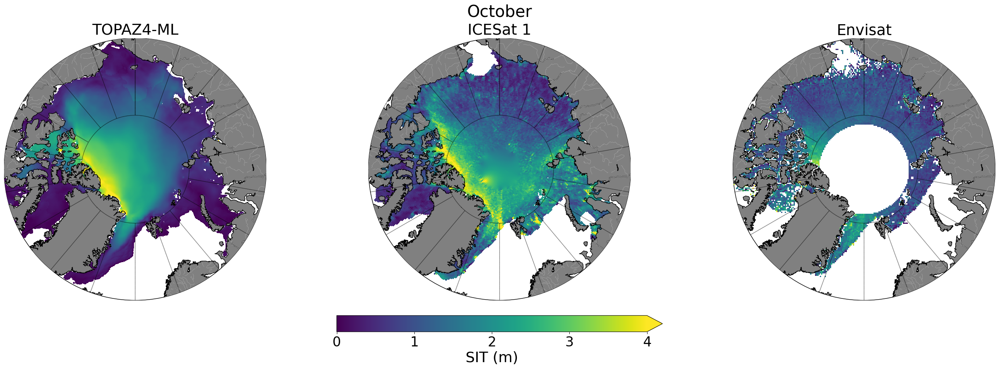

In [39]:
draw_3basemap_avg(sit_mm_oct, sit_is_oct, sit_en_oct, 'October', odir=odir, savefig=False)

/tmp/ipykernel_45327/1193199258.py:60: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m3.pcolormesh(mlons, mlats, sit_en, vmin=vmin, vmax=vmax, **kwargs)


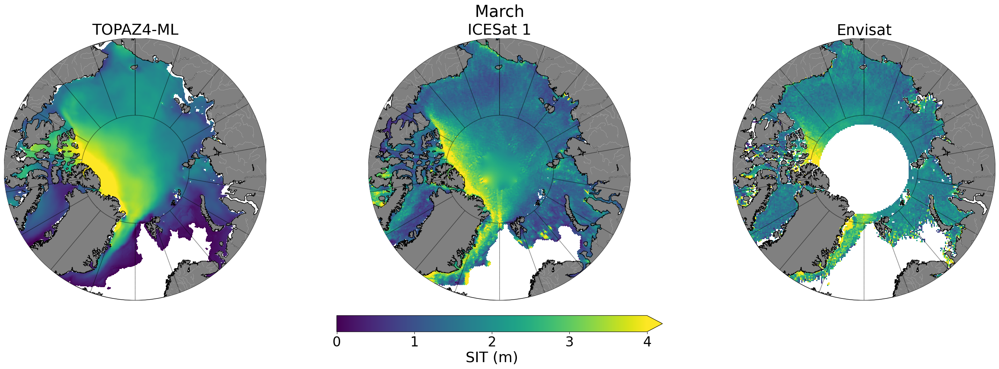

In [40]:
draw_3basemap_avg(sit_mm_mar, sit_is_mar, sit_en_mar, 'March', odir=odir, savefig=False)

/tmp/ipykernel_45327/1051393367.py:63: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m3.pcolormesh(mlons, mlats, sit_en, vmin=vmin, vmax=vmax, **kwargs)


Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat_240524-173523/SIT_TP4ML_FR_BL_ICESAT1_ENVISAT_October.png


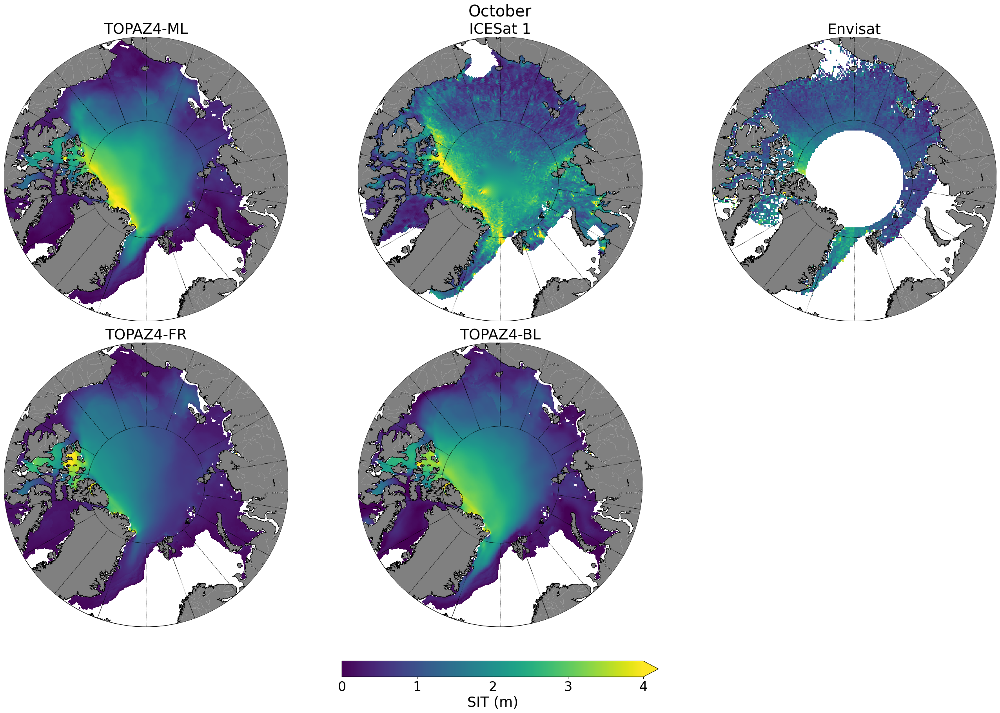

In [44]:
draw_6basemap_avg(sit_mm_oct, sit_is_oct, sit_en_oct,
                  sit_fr_oct, sit_bl_oct,
                  'October', odir=odir, savefig=True)

/tmp/ipykernel_45327/1051393367.py:63: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m3.pcolormesh(mlons, mlats, sit_en, vmin=vmin, vmax=vmax, **kwargs)


Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat_240524-173523/SIT_TP4ML_FR_BL_ICESAT1_ENVISAT_March.png


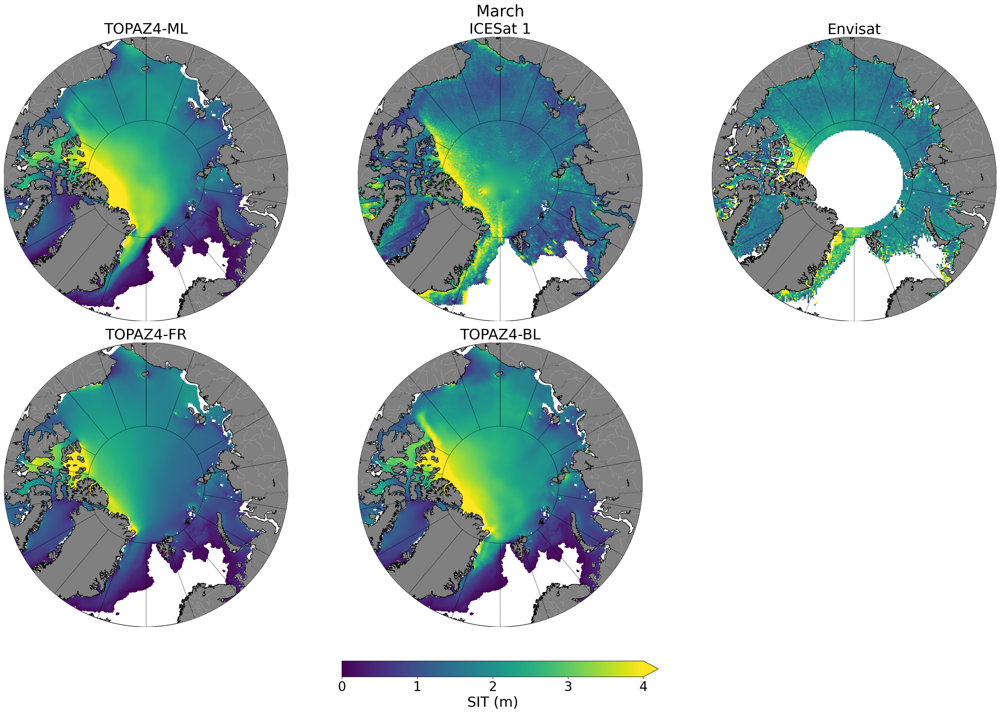

In [45]:
draw_6basemap_avg(sit_mm_mar, sit_is_mar, sit_en_mar, 
                  sit_fr_mar, sit_bl_mar,
                  'March', odir=odir, savefig=True)

# Plot

In [43]:
# odir = '/scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat/'
# odir = '/scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat_240523-170100/'  # best ?
odir = '/scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat_240524-173523/'  # best? N24

In [21]:
days = np.array([dt.date() for dt in chrono_is.date])

/tmp/ipykernel_239595/2152474708.py:76: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m3.pcolormesh(mlons, mlats, sit_en.isel(time=tidx_en[0]), vmin=vmin, vmax=vmax, **kwargs)


Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat_240507-160345/SIT_TP4ML_ICESAT1_ENVISAT_200310.png


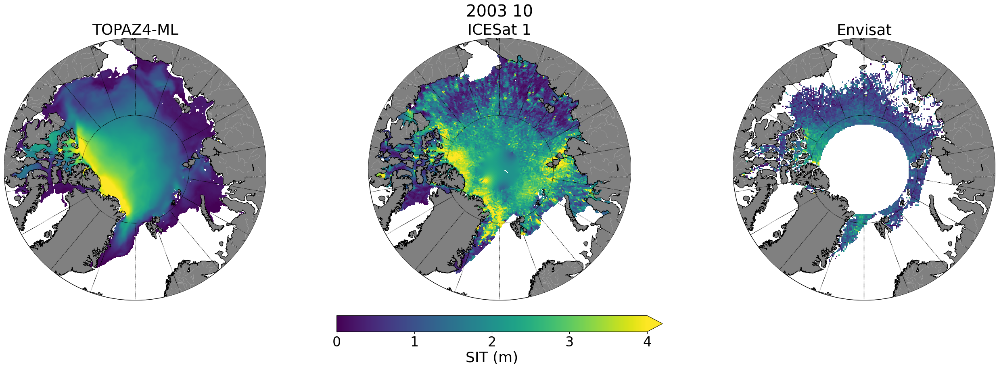

In [25]:
draw_3basemap(sit_mm, sit_is, sit_en, days[1], odir=odir, savefig=True)

/tmp/ipykernel_239595/333720665.py:87: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m3.pcolormesh(mlons, mlats, sit_en.isel(time=tidx_en[0]), vmin=vmin, vmax=vmax, **kwargs)


Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat_240507-160345/SIT_TP4ML_FR_BL_ICESAT1_ENVISAT_200303.png


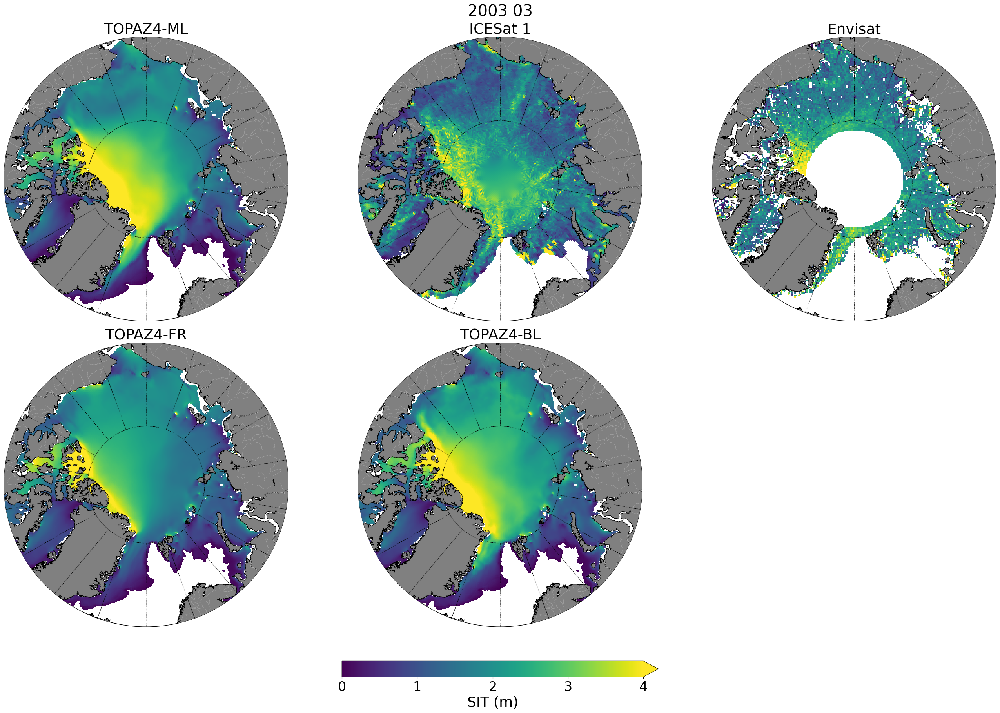

/tmp/ipykernel_239595/333720665.py:87: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m3.pcolormesh(mlons, mlats, sit_en.isel(time=tidx_en[0]), vmin=vmin, vmax=vmax, **kwargs)


Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat_240507-160345/SIT_TP4ML_FR_BL_ICESAT1_ENVISAT_200310.png


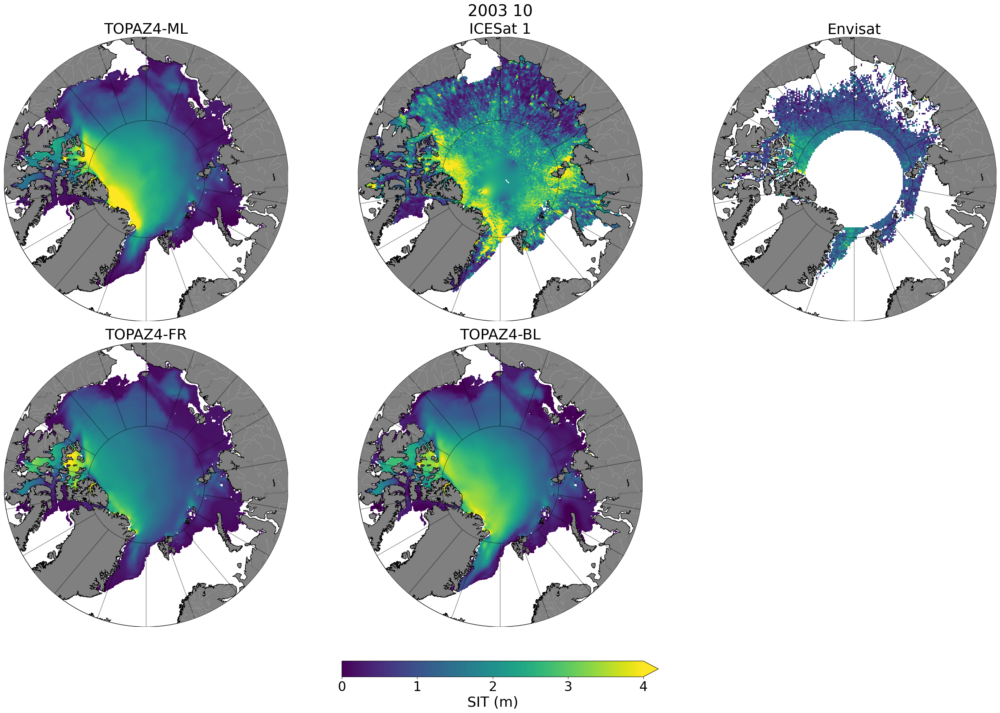

/tmp/ipykernel_239595/333720665.py:87: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m3.pcolormesh(mlons, mlats, sit_en.isel(time=tidx_en[0]), vmin=vmin, vmax=vmax, **kwargs)


Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat_240507-160345/SIT_TP4ML_FR_BL_ICESAT1_ENVISAT_200403.png


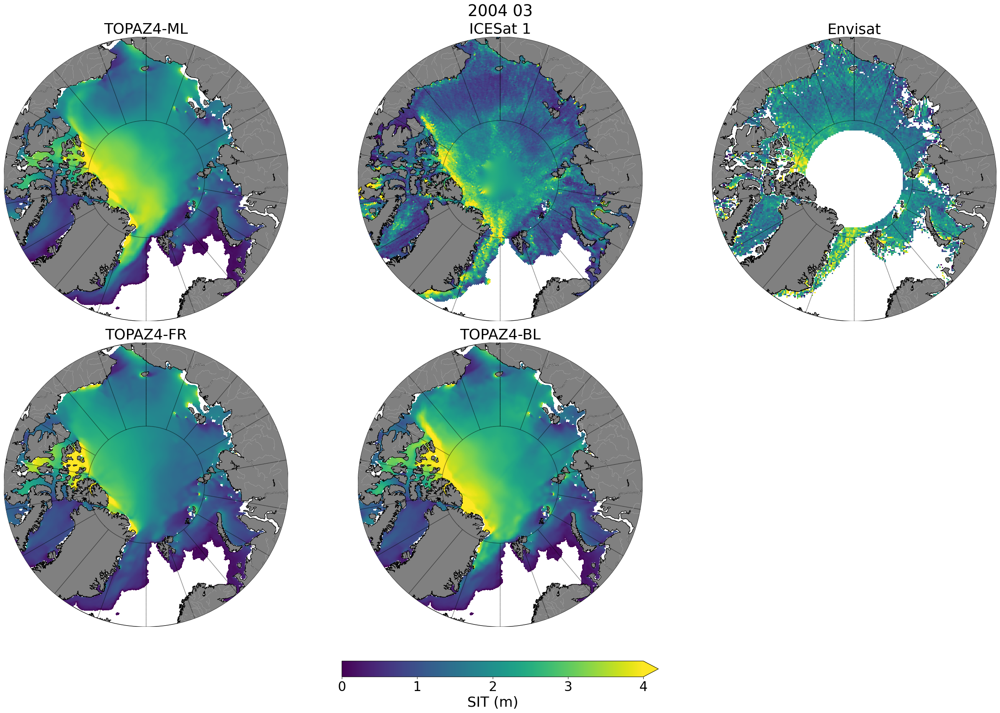

/tmp/ipykernel_239595/333720665.py:87: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m3.pcolormesh(mlons, mlats, sit_en.isel(time=tidx_en[0]), vmin=vmin, vmax=vmax, **kwargs)


Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat_240507-160345/SIT_TP4ML_FR_BL_ICESAT1_ENVISAT_200410.png


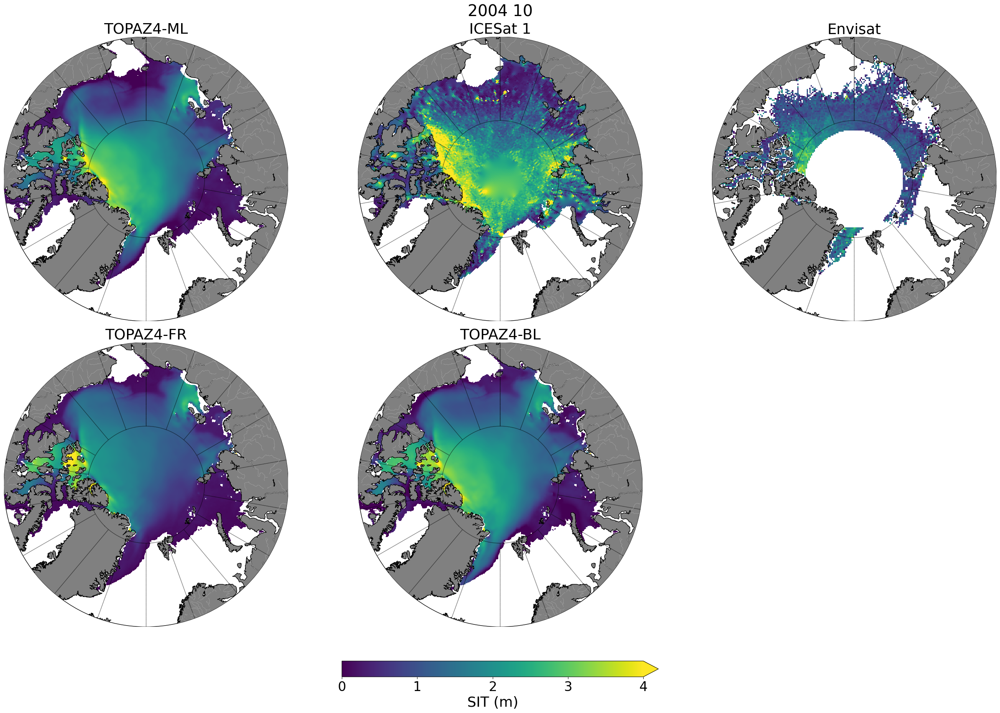

/tmp/ipykernel_239595/333720665.py:87: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m3.pcolormesh(mlons, mlats, sit_en.isel(time=tidx_en[0]), vmin=vmin, vmax=vmax, **kwargs)


Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat_240507-160345/SIT_TP4ML_FR_BL_ICESAT1_ENVISAT_200503.png


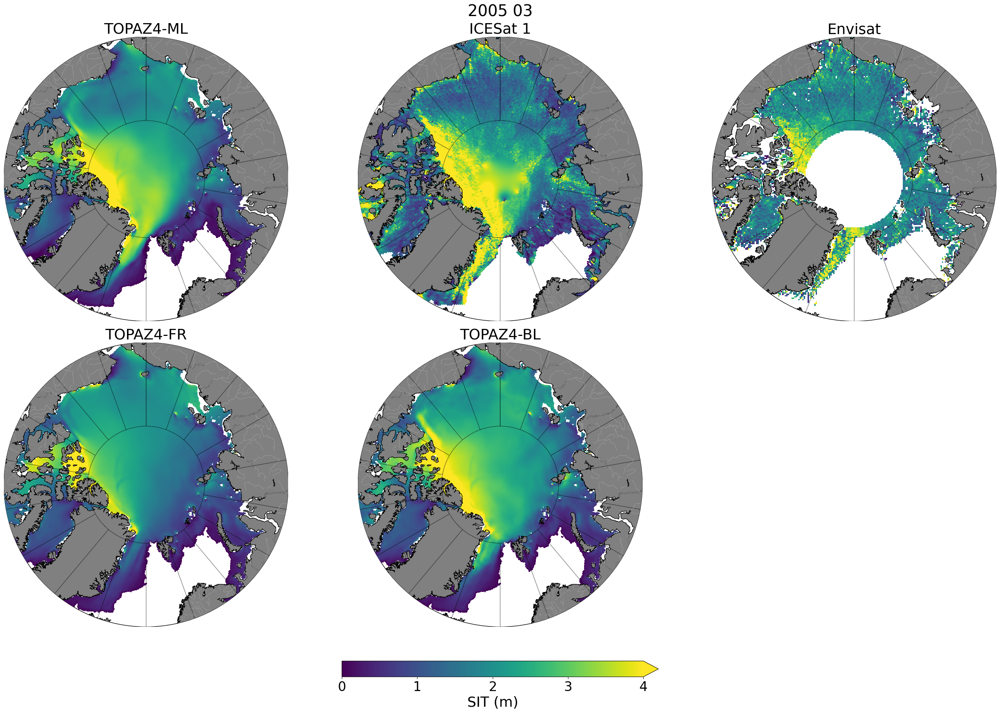

/tmp/ipykernel_239595/333720665.py:87: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m3.pcolormesh(mlons, mlats, sit_en.isel(time=tidx_en[0]), vmin=vmin, vmax=vmax, **kwargs)


Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat_240507-160345/SIT_TP4ML_FR_BL_ICESAT1_ENVISAT_200511.png


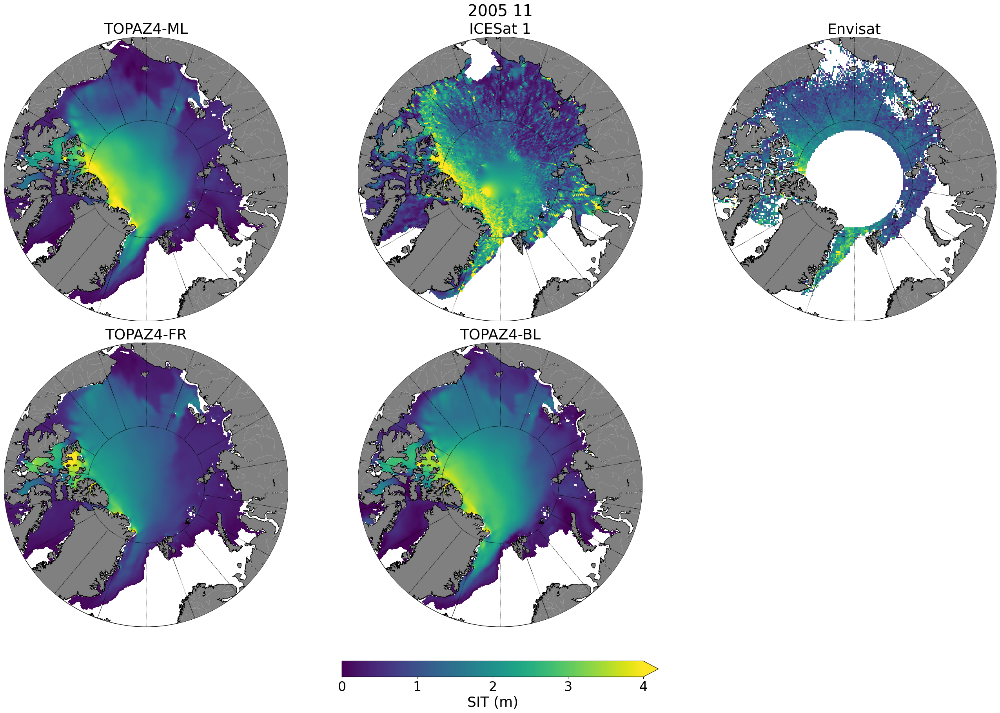

/tmp/ipykernel_239595/333720665.py:87: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m3.pcolormesh(mlons, mlats, sit_en.isel(time=tidx_en[0]), vmin=vmin, vmax=vmax, **kwargs)


Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat_240507-160345/SIT_TP4ML_FR_BL_ICESAT1_ENVISAT_200603.png


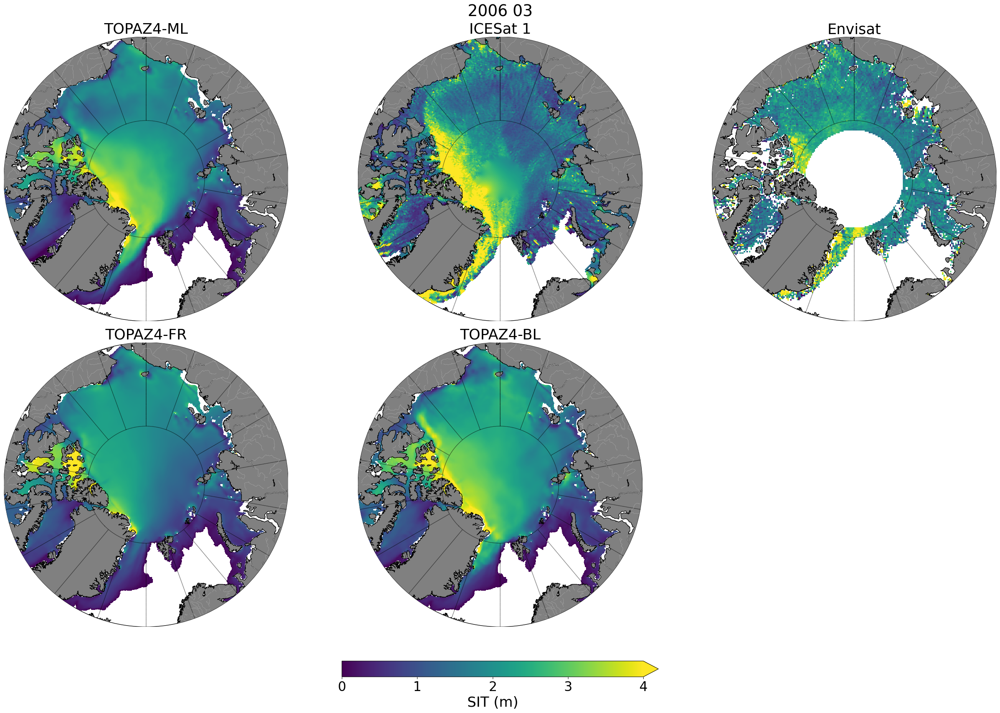

/tmp/ipykernel_239595/333720665.py:87: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m3.pcolormesh(mlons, mlats, sit_en.isel(time=tidx_en[0]), vmin=vmin, vmax=vmax, **kwargs)


Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat_240507-160345/SIT_TP4ML_FR_BL_ICESAT1_ENVISAT_200611.png


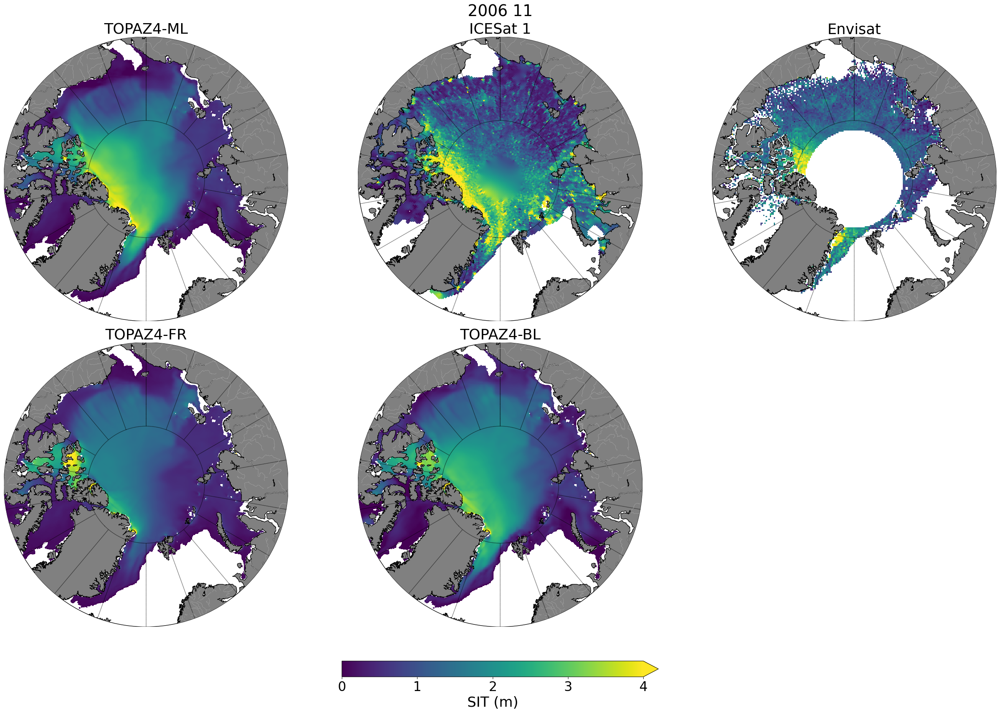

/tmp/ipykernel_239595/333720665.py:87: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m3.pcolormesh(mlons, mlats, sit_en.isel(time=tidx_en[0]), vmin=vmin, vmax=vmax, **kwargs)


Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat_240507-160345/SIT_TP4ML_FR_BL_ICESAT1_ENVISAT_200703.png


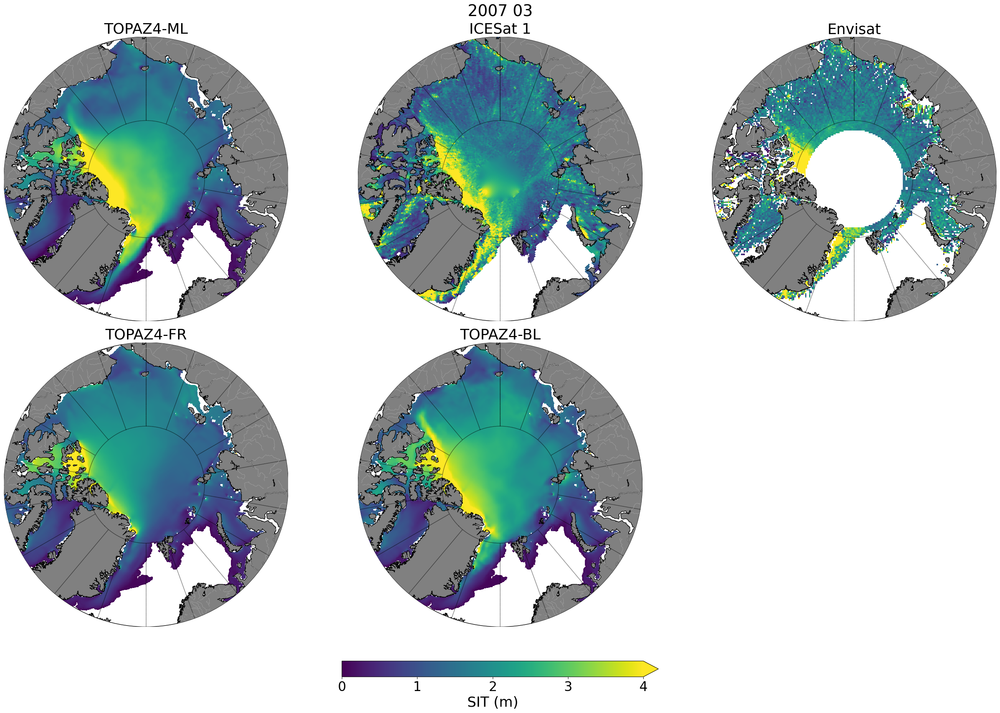

/tmp/ipykernel_239595/333720665.py:87: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m3.pcolormesh(mlons, mlats, sit_en.isel(time=tidx_en[0]), vmin=vmin, vmax=vmax, **kwargs)


Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat_240507-160345/SIT_TP4ML_FR_BL_ICESAT1_ENVISAT_200710.png


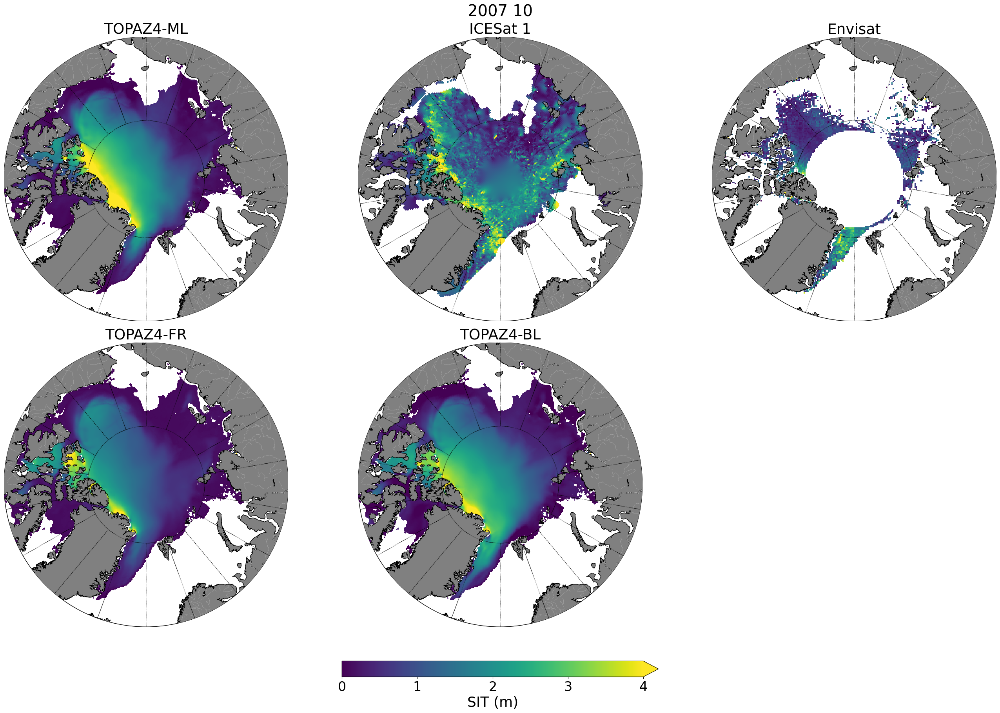

/tmp/ipykernel_239595/333720665.py:87: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  m3.pcolormesh(mlons, mlats, sit_en.isel(time=tidx_en[0]), vmin=vmin, vmax=vmax, **kwargs)


Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat_240507-160345/SIT_TP4ML_FR_BL_ICESAT1_ENVISAT_200803.png


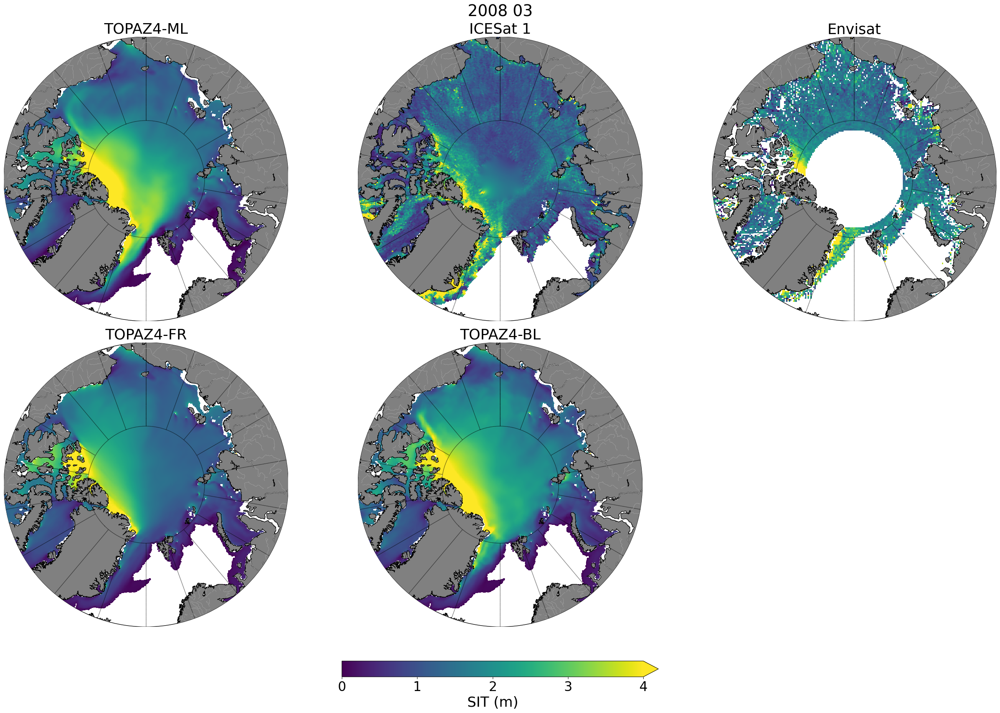

In [43]:
for dy in days:
#     draw_3basemap(sit_mm, sit_is, sit_en, dy, odir=odir, savefig=True)
    draw_6basemap(sit_mm, sit_is, sit_en, sit_mm_fr, sit_mm_bl, dy, odir=odir, savefig=True)

# vvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvvv

# TODO: plot with TOPAZ4-BL, TOPAZ4-FR 
# TODO: histogram with same 

# ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^

Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat/SIT_hist_TP4ML_FR_BL_ICESAT1_ENVISAT_200303.png


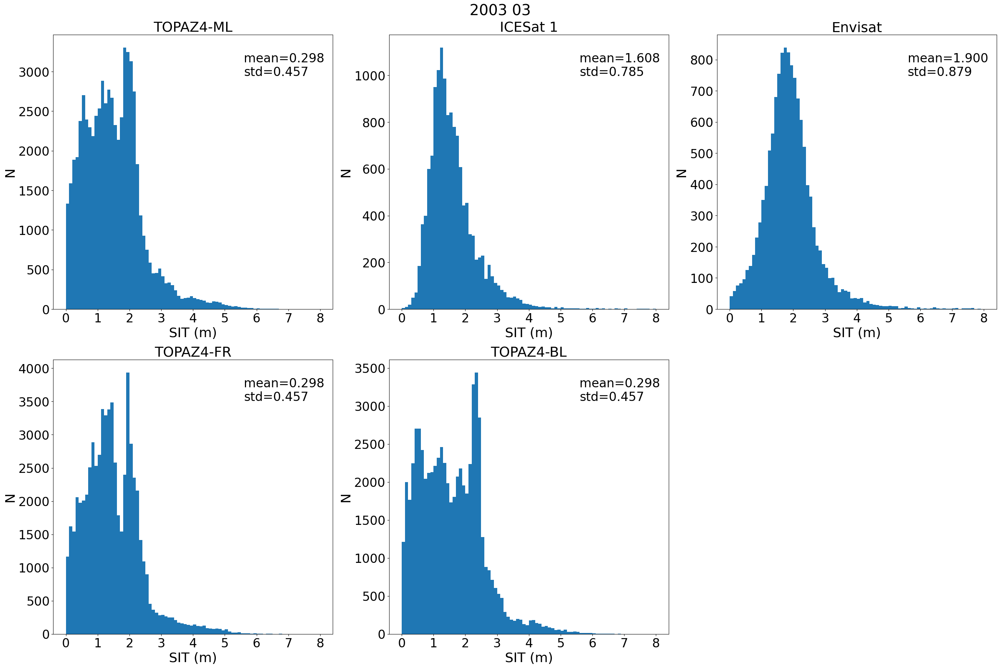

Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat/SIT_hist_TP4ML_FR_BL_ICESAT1_ENVISAT_200310.png


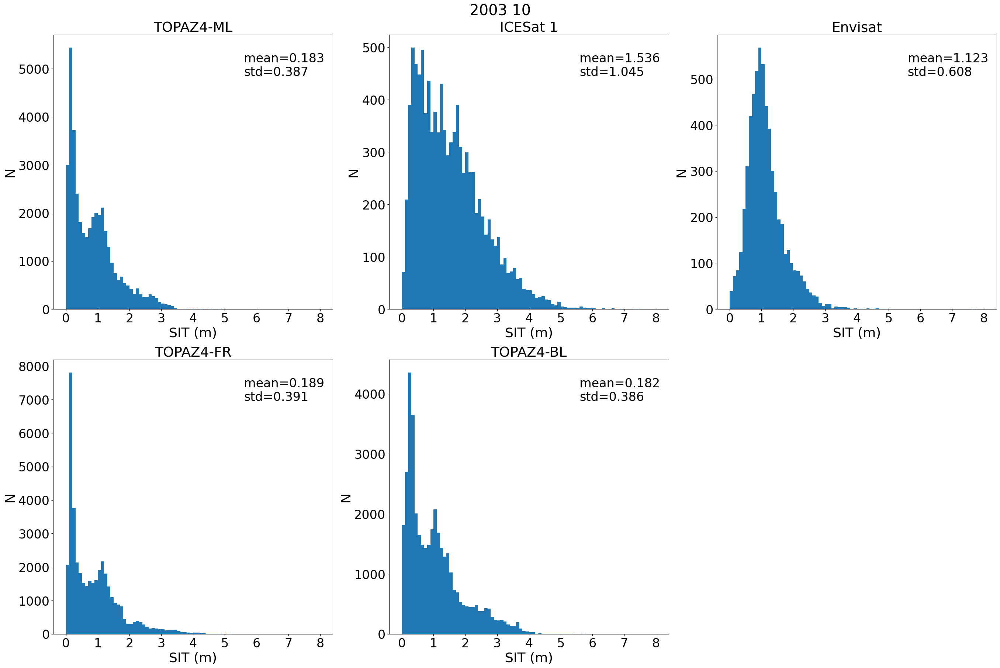

Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat/SIT_hist_TP4ML_FR_BL_ICESAT1_ENVISAT_200403.png


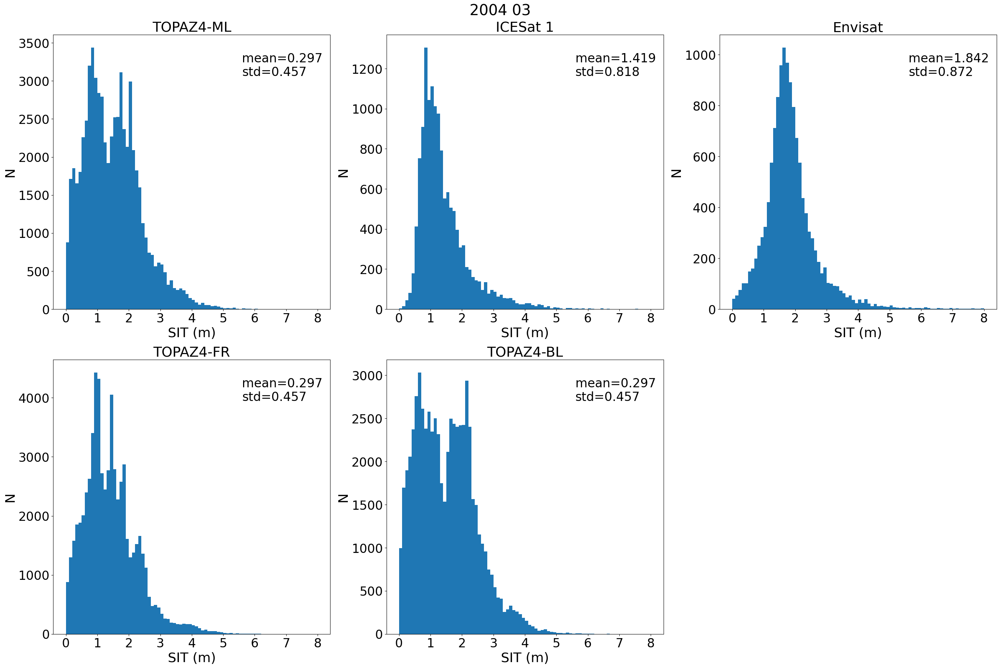

Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat/SIT_hist_TP4ML_FR_BL_ICESAT1_ENVISAT_200410.png


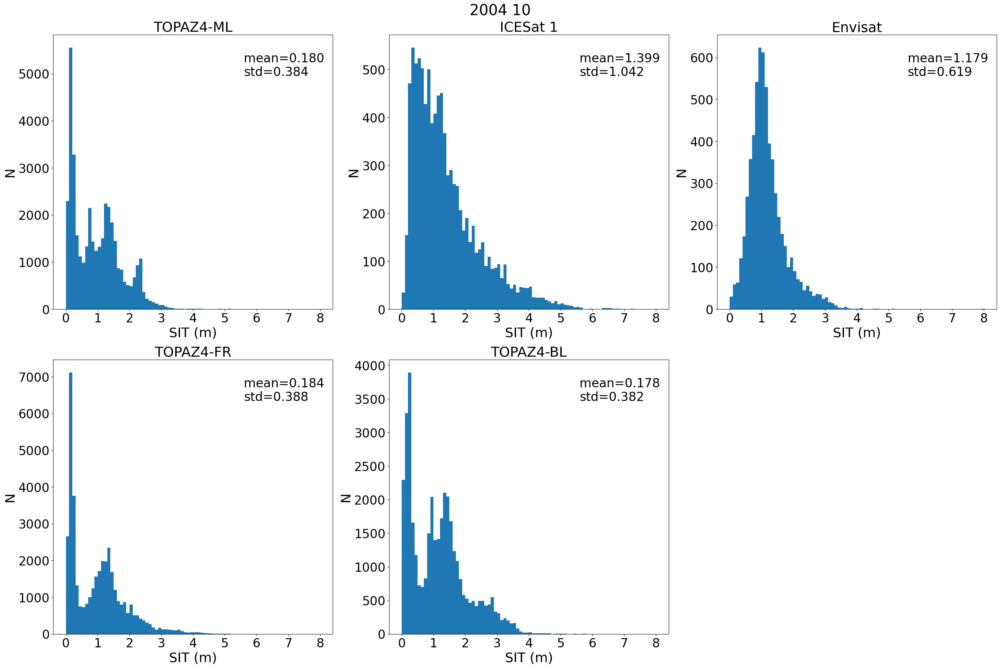

Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat/SIT_hist_TP4ML_FR_BL_ICESAT1_ENVISAT_200503.png


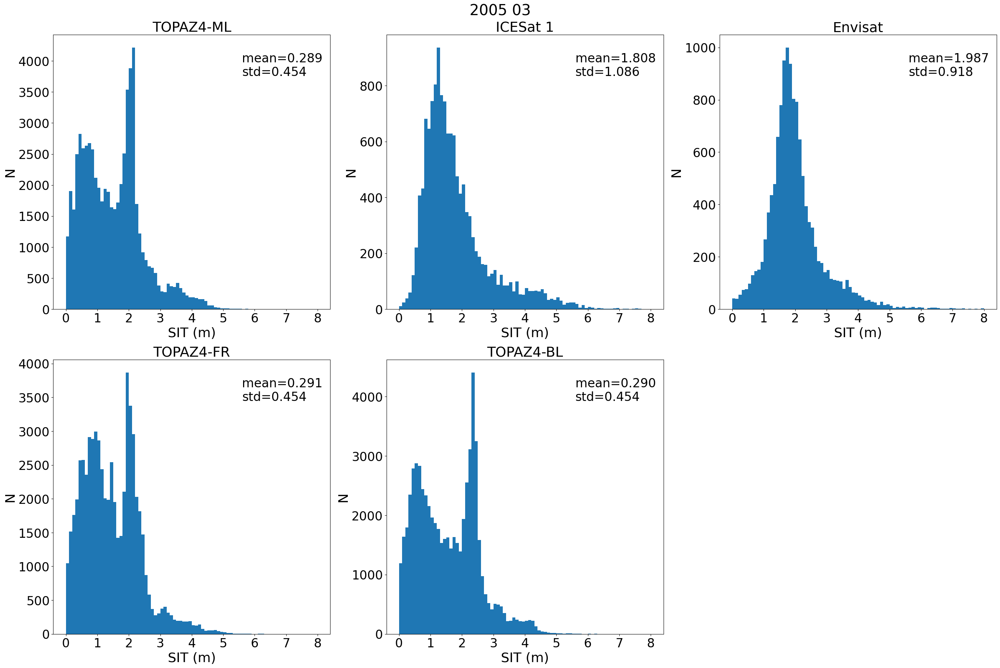

Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat/SIT_hist_TP4ML_FR_BL_ICESAT1_ENVISAT_200511.png


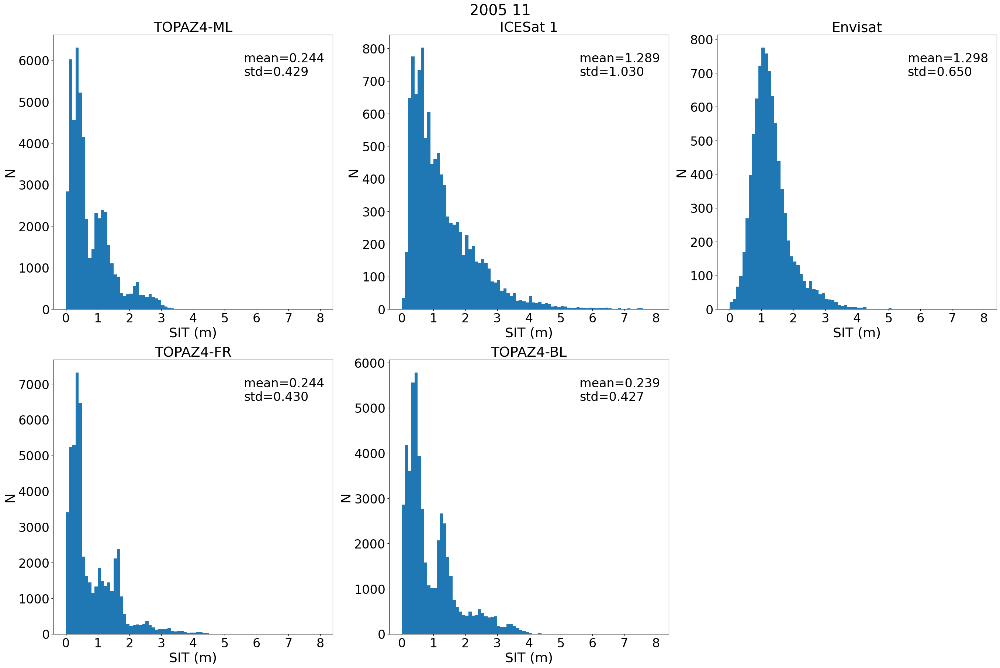

Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat/SIT_hist_TP4ML_FR_BL_ICESAT1_ENVISAT_200603.png


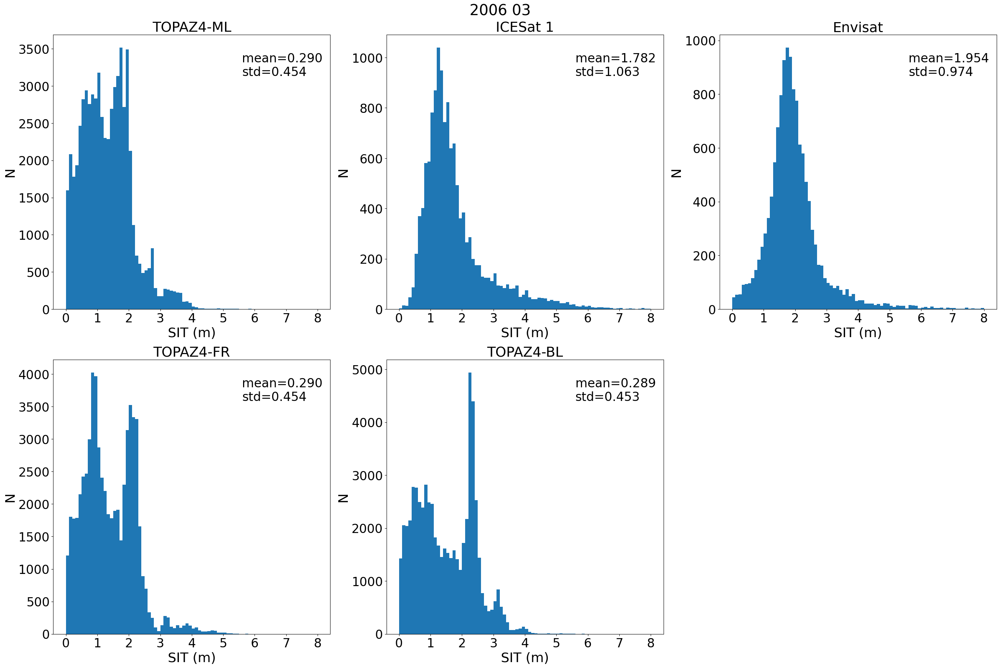

Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat/SIT_hist_TP4ML_FR_BL_ICESAT1_ENVISAT_200611.png


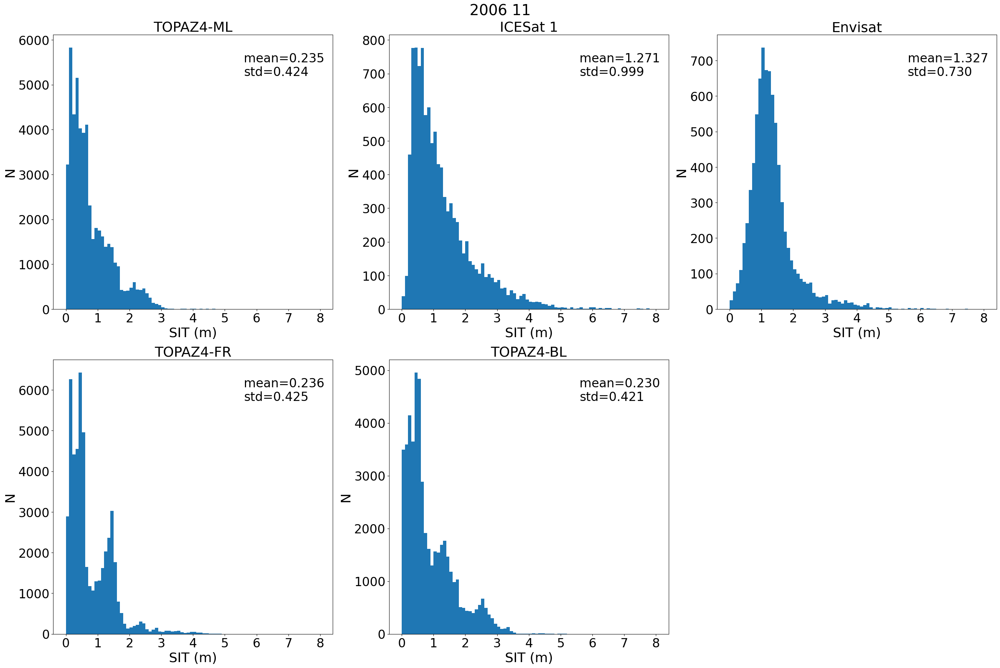

Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat/SIT_hist_TP4ML_FR_BL_ICESAT1_ENVISAT_200703.png


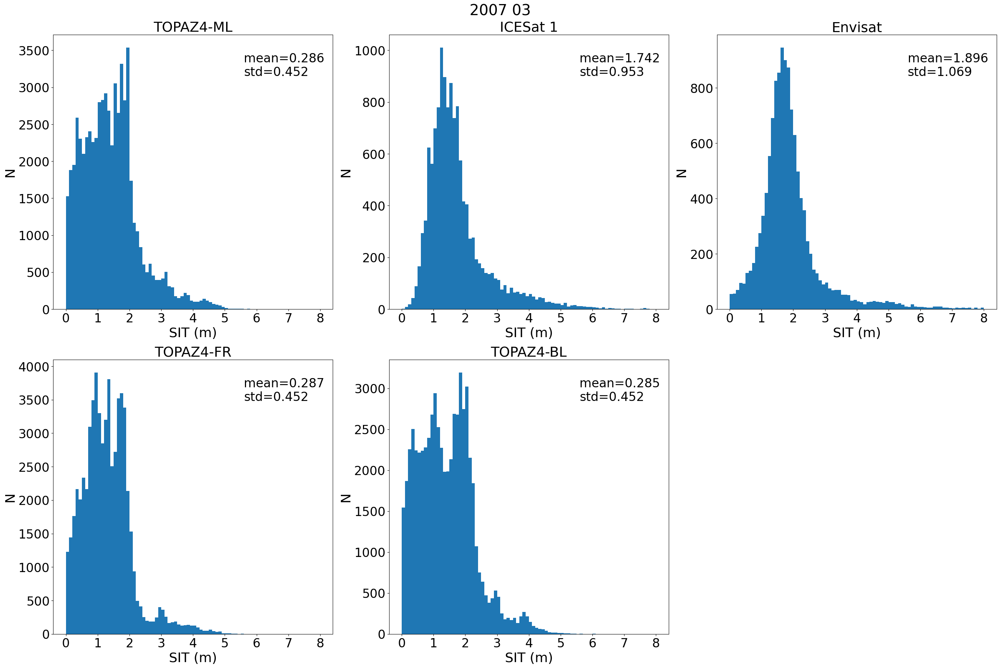

Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat/SIT_hist_TP4ML_FR_BL_ICESAT1_ENVISAT_200710.png


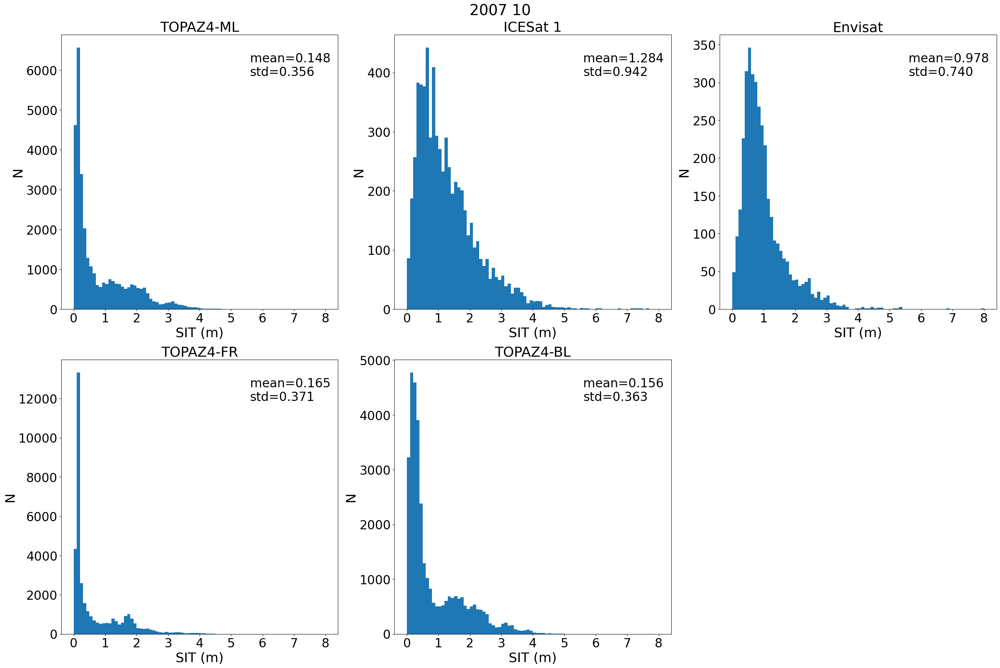

Figure saved as : /scratch/project_465000269/edelleo1/Leo/intercomp/tp4_icesat1_envisat/SIT_hist_TP4ML_FR_BL_ICESAT1_ENVISAT_200803.png


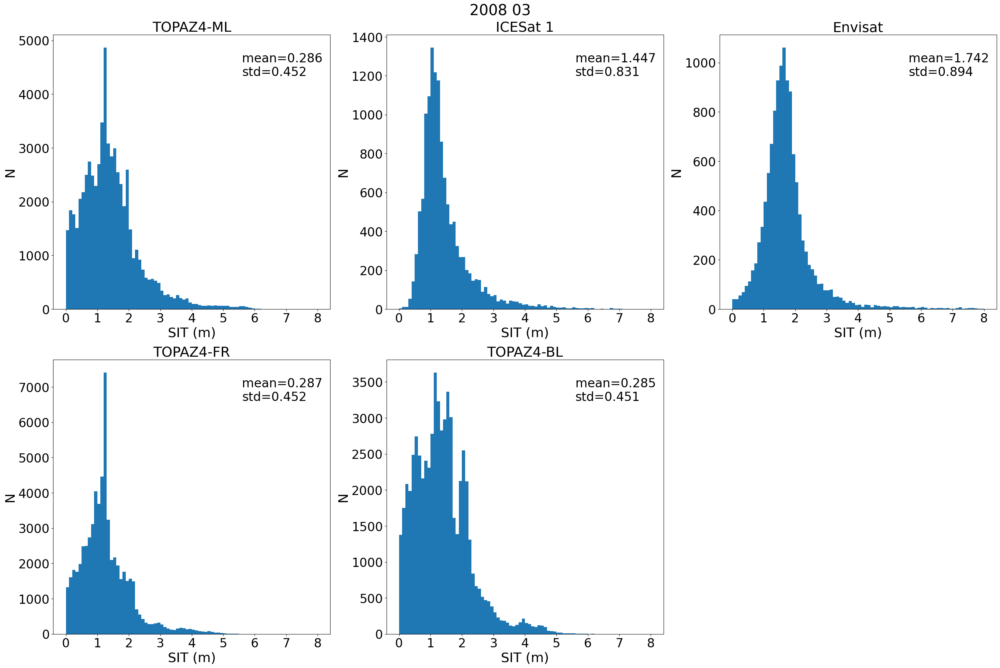

In [167]:
for dy in days:
#     draw_3hist(sit_mm, sit_is, sit_en, dy, odir=odir, savefig=True) 
    draw_6hist(sit_mm, sit_is, sit_en, sit_mm_fr, sit_mm_bl, dy, odir=odir, savefig=True)

# Plot

In [32]:
def draw_6hist(sit_ml, sit_is, sit_en,
               sit_fr, sit_bl,
               day, bins=None,
               odir='', savefig=False, showfig=True, **kwargs):
    '''
    Parameters:
    -----------
    
        sit_ml       : Sea Ice Thickness from TOPAZ4-ML
        sit_is       : Sea Ice Thickness from ICESat 1
        sit_en       : Sea Ice Thickness from Envisat
        day          : datetime.date() object, first of the month to plot
    
    '''
    
    if bins is None:
        bin_width = 0.1
        bins = np.arange(0,8+bin_width,bin_width)

    
     # identify index to plot for TOPAZ4-ML
    chrono = pd.DataFrame({'date':pd.to_datetime(sit_ml.time.to_numpy())})
    chrono_dt = np.array([dt.date() for dt in chrono.date])
    tidx_ml = np.where(chrono_dt==day)[0]  
    
    chrono = pd.DataFrame({'date':pd.to_datetime(sit_fr.time.to_numpy())})
    chrono_dt = np.array([dt.date() for dt in chrono.date])
    tidx_fr = np.where(chrono_dt==day)[0]  
    
    chrono = pd.DataFrame({'date':pd.to_datetime(sit_bl.time.to_numpy())})
    chrono_dt = np.array([dt.date() for dt in chrono.date])
    tidx_bl = np.where(chrono_dt==day)[0]  
    
    # identify index to plot for ICESat1
    chrono = pd.DataFrame({'date':pd.to_datetime(sit_is.time.to_numpy())})
    chrono_dt = np.array([dt.date() for dt in chrono.date])
    tidx_is = np.where(chrono_dt==day)[0]  
    
    # identify index to plot for Envisat
    chrono = pd.DataFrame({'date':pd.to_datetime(sit_en.time.to_numpy())})
    chrono_dt = np.array([dt.date() for dt in chrono.date])
    tidx_en = np.where(chrono_dt==day)[0]  
    
    
    fig, axes = plt.subplots(ncols=3, nrows=2, figsize=(9*3, 9*2), constrained_layout=True)
    axes = axes.flatten()
    # -------------------------------------------------------------------------------

    #remove lat > 81.5N
    sit_ml_ = sit_ml.isel(time=tidx_ml[0]).where(sit_ml.latitude<=81.5) # .where(sit_ml.isel(time=tidx_ml[0])>0.1)
    sit_ml_ = sit_ml_.to_numpy().reshape((sit_ml.shape[1]*sit_ml.shape[2],1))
    
    axes[0].hist(sit_ml_, bins=bins)

    axes[0].set_ylabel('N')
    axes[0].set_xlabel('SIT (m)')
    axes[0].set_title('TOPAZ4-ML')
    
    # -------------------------------------------------------------------------------
    
    #remove lat > 81.5N
    sit_is_ = sit_is.isel(time=tidx_is[0]).where(sit_is.lat<=81.5)
    sit_is_ = sit_is_.to_numpy().reshape((sit_is.shape[1]*sit_is.shape[2], 1))
    
    axes[1].hist(sit_is_, bins=bins)
    
    axes[1].set_ylabel('N')
    axes[1].set_xlabel('SIT (m)')
    axes[1].set_title('ICESat 1')
    
    # -------------------------------------------------------------------------------
    
    sit_en_ = sit_en.isel(time=tidx_en[0]).to_numpy().reshape((sit_en.shape[1]*sit_en.shape[2], 1))
    
    axes[2].hist(sit_en_, bins=bins)
  
    axes[2].set_ylabel('N')
    axes[2].set_xlabel('SIT (m)')
    axes[2].set_title('Envisat')
    
    # -------------------------------------------------------------------------------
    
    #remove lat > 81.5N
    sit_fr_ = sit_fr.isel(time=tidx_fr[0]).where(sit_fr.latitude<=81.5) # .where(sit_ml.isel(time=tidx_ml[0])>0.1)
    sit_fr_ = sit_fr_.to_numpy().reshape((sit_fr.shape[1]*sit_fr.shape[2],1))
    
    axes[3].hist(sit_fr_, bins=bins)

    axes[3].set_ylabel('N')
    axes[3].set_xlabel('SIT (m)')
    axes[3].set_title('TOPAZ4-FR')
    
    # -------------------------------------------------------------------------------
    
    #remove lat > 81.5N
    sit_bl_ = sit_bl.isel(time=tidx_bl[0]).where(sit_bl.latitude<=81.5) # .where(sit_ml.isel(time=tidx_ml[0])>0.1)
    sit_bl_ = sit_bl_.to_numpy().reshape((sit_bl.shape[1]*sit_bl.shape[2],1))
    
    axes[4].hist(sit_bl_, bins=bins)

    axes[4].set_ylabel('N')
    axes[4].set_xlabel('SIT (m)')
    axes[4].set_title('TOPAZ4-BL')
    
    # -------------------------------------------------------------------------------
    axes[5].set_visible(False)
    
    
    # annotate mean + std
    
    _, xmax = axes[0].get_xlim()
    _, ymax = axes[0].get_ylim()
    
#     import pdb; pdb.set_trace()
    
    axes[0].annotate(f'mean={np.nanmean(sit_ml_>0):.03f}',(xmax-xmax/3., ymax-ymax/10.))
    axes[0].annotate(f'std={np.nanstd(sit_ml_>0):.03f}',(xmax-xmax/3., ymax- 1.5*ymax/10.))
    
    _, xmax = axes[1].get_xlim()
    _, ymax = axes[1].get_ylim()
    
    axes[1].annotate(f'mean={np.nanmean(sit_is_):.03f}',(xmax-xmax/3., ymax-ymax/10.))
    axes[1].annotate(f'std={np.nanstd(sit_is_):.03f}',(xmax-xmax/3., ymax- 1.5*ymax/10.))
    
    _, xmax = axes[2].get_xlim()
    _, ymax = axes[2].get_ylim()
    
    axes[2].annotate(f'mean={np.nanmean(sit_en_):.03f}',(xmax-xmax/3., ymax-ymax/10.))
    axes[2].annotate(f'std={np.nanstd(sit_en_):.03f}',(xmax-xmax/3., ymax- 1.5*ymax/10.))
    
    _, xmax = axes[3].get_xlim()
    _, ymax = axes[3].get_ylim()
    
    axes[3].annotate(f'mean={np.nanmean(sit_fr_>0):.03f}',(xmax-xmax/3., ymax-ymax/10.))
    axes[3].annotate(f'std={np.nanstd(sit_fr_>0):.03f}',(xmax-xmax/3., ymax- 1.5*ymax/10.))
    
    _, xmax = axes[4].get_xlim()
    _, ymax = axes[4].get_ylim()
    
    axes[4].annotate(f'mean={np.nanmean(sit_bl_>0):.03f}',(xmax-xmax/3., ymax-ymax/10.))
    axes[4].annotate(f'std={np.nanstd(sit_bl_>0):.03f}',(xmax-xmax/3., ymax- 1.5*ymax/10.))
    
    # -------------------------------------------------------------------------------
    
    
    
    fig.suptitle(f'{day.strftime("%Y %m")}')
    modif_plot.resize(fig, s=24)
    
    if savefig:
        sdate = f'{day.strftime("%Y%m")}'
        ofile = f'SIT_hist_TP4ML_FR_BL_ICESAT1_ENVISAT_{sdate}.png'    
        plt.savefig(f"{odir}{ofile}", dpi=120, facecolor='white')
        print(f'Figure saved as : {odir}{ofile}')
        
    if showfig:
        plt.show()
        
    plt.close()


In [33]:
def draw_6basemap(sit_ml, sit_is, sit_en, 
                  sit_fr, sit_bl,
                  day,
                  odir='', savefig=False, showfig=True, **kwargs):
    '''
    Parameters:
    -----------
    
        sit_ml       : Sea Ice Thickness from TOPAZ4-ML
        sit_is       : Sea Ice Thickness from ICESat 1
        sit_en       : Sea Ice Thickness from Envisat
        day          : datetime.date() object, first of the month to plot
    
    '''
    
    vmin = 0
    vmax = 4

    
     # identify index to plot for TOPAZ4-ML
    chrono = pd.DataFrame({'date':pd.to_datetime(sit_ml.time.to_numpy())})
    chrono_dt = np.array([dt.date() for dt in chrono.date])
    tidx_ml = np.where(chrono_dt==day)[0]  
    
    chrono = pd.DataFrame({'date':pd.to_datetime(sit_fr.time.to_numpy())})
    chrono_dt = np.array([dt.date() for dt in chrono.date])
    tidx_fr = np.where(chrono_dt==day)[0]  
    
    chrono = pd.DataFrame({'date':pd.to_datetime(sit_bl.time.to_numpy())})
    chrono_dt = np.array([dt.date() for dt in chrono.date])
    tidx_bl = np.where(chrono_dt==day)[0]  
    
    # identify index to plot for ICESat1
    chrono = pd.DataFrame({'date':pd.to_datetime(sit_is.time.to_numpy())})
    chrono_dt = np.array([dt.date() for dt in chrono.date])
    tidx_is = np.where(chrono_dt==day)[0]  
    
    # identify index to plot for Envisat
    chrono = pd.DataFrame({'date':pd.to_datetime(sit_en.time.to_numpy())})
    chrono_dt = np.array([dt.date() for dt in chrono.date])
    tidx_en = np.where(chrono_dt==day)[0]  
    
    
    fig, axes = plt.subplots(ncols=3, nrows=2, figsize=(9*3, 9*2
                                                       ), constrained_layout=True)
    axes = axes.flatten()
    # -------------------------------------------------------------------------------
    
    m = Basemap(projection='npstere', boundinglat=66, lon_0=0, resolution='l', round=True, ax=axes[0])
    m.drawcoastlines()
    m.drawparallels(np.arange(-80.,81.,20.))
    m.drawmeridians(np.arange(-180.,181.,20.))
    m.fillcontinents(color='grey', lake_color='w')
    m.drawrivers(color='darkgrey')
    
    mlons, mlats = m(sit_ml.longitude, sit_ml.latitude)    
    cs = m.pcolormesh(mlons, mlats, sit_ml.isel(time=tidx_ml[0]), vmin=vmin, vmax=vmax, **kwargs)

    axes[0].set_title('TOPAZ4-ML')
    
    # -------------------------------------------------------------------------------
    
    
    m2 = Basemap(projection='npstere', boundinglat=66, lon_0=0, resolution='l', round=True, ax=axes[1])
    m2.drawcoastlines()
    m2.drawparallels(np.arange(-80.,81.,20.))
    m2.drawmeridians(np.arange(-180.,181.,20.))
    m2.fillcontinents(color='grey', lake_color='w')
    m2.drawrivers(color='darkgrey')
    
    mlons, mlats = m2(sit_is.lon, sit_is.lat)
    m2.pcolormesh(mlons, mlats, sit_is.isel(time=tidx_is[0]), vmin=vmin, vmax=vmax, **kwargs)
    
    axes[1].set_title('ICESat 1')
    
    # -------------------------------------------------------------------------------
    
    
    m3 = Basemap(projection='npstere', boundinglat=66, lon_0=0, resolution='l', round=True, ax=axes[2])
    m3.drawcoastlines()
    m3.drawparallels(np.arange(-80.,81.,20.))
    m3.drawmeridians(np.arange(-180.,181.,20.))
    m3.fillcontinents(color='grey', lake_color='w')
    m3.drawrivers(color='darkgrey')
    
    mlons, mlats = m3(sit_en.lon, sit_en.lat)
    m3.pcolormesh(mlons, mlats, sit_en.isel(time=tidx_en[0]), vmin=vmin, vmax=vmax, **kwargs)
    
    axes[2].set_title('Envisat')
    
    # -------------------------------------------------------------------------------
    
    m4 = Basemap(projection='npstere', boundinglat=66, lon_0=0, resolution='l', round=True, ax=axes[3])
    m4.drawcoastlines()
    m4.drawparallels(np.arange(-80.,81.,20.))
    m4.drawmeridians(np.arange(-180.,181.,20.))
    m4.fillcontinents(color='grey', lake_color='w')
    m4.drawrivers(color='darkgrey')
    
    mlons, mlats = m4(sit_ml.longitude, sit_ml.latitude)    
    m4.pcolormesh(mlons, mlats, sit_fr.isel(time=tidx_fr[0]), vmin=vmin, vmax=vmax, **kwargs)

    axes[3].set_title('TOPAZ4-FR')
    
    # -------------------------------------------------------------------------------
    
    m5 = Basemap(projection='npstere', boundinglat=66, lon_0=0, resolution='l', round=True, ax=axes[4])
    m5.drawcoastlines()
    m5.drawparallels(np.arange(-80.,81.,20.))
    m5.drawmeridians(np.arange(-180.,181.,20.))
    m5.fillcontinents(color='grey', lake_color='w')
    m5.drawrivers(color='darkgrey')
    
    mlons, mlats = m5(sit_bl.longitude, sit_ml.latitude)    
    m5.pcolormesh(mlons, mlats, sit_bl.isel(time=tidx_bl[0]), vmin=vmin, vmax=vmax, **kwargs)

    axes[4].set_title('TOPAZ4-BL')
    
    # -------------------------------------------------------------------------------
    
    axes[5].set_visible(False)
    
    cbar = fig.colorbar(cs, ax=axes, shrink=0.3, location="bottom", extend='max', label='SIT (m)')
    cbar.ax.set_xticks([0,1,2,3,4])
    
    
    fig.suptitle(f'{day.strftime("%Y %m")}')
    modif_plot.resize(fig, s=24)
    
    if savefig:
        sdate = f'{day.strftime("%Y%m")}'
        ofile = f'SIT_TP4ML_FR_BL_ICESAT1_ENVISAT_{sdate}.png'    
        plt.savefig(f"{odir}{ofile}", dpi=120, facecolor='white')
        print(f'Figure saved as : {odir}{ofile}')
        
    if showfig:
        plt.show()
        
    plt.close()


In [34]:
def draw_3hist(sit_ml, sit_is, sit_en, day, bins=None,
               odir='', savefig=False, showfig=True, **kwargs):
    '''
    Parameters:
    -----------
    
        sit_ml       : Sea Ice Thickness from TOPAZ4-ML
        sit_is       : Sea Ice Thickness from ICESat 1
        sit_en       : Sea Ice Thickness from Envisat
        day          : datetime.date() object, first of the month to plot
    
    '''
    
    if bins is None:
        bin_width = 0.1
        bins = np.arange(0,8+bin_width,bin_width)

    
     # identify index to plot for TOPAZ4-ML
    chrono = pd.DataFrame({'date':pd.to_datetime(sit_ml.time.to_numpy())})
    chrono_dt = np.array([dt.date() for dt in chrono.date])
    tidx_ml = np.where(chrono_dt==day)[0]  
    
    # identify index to plot for TOPAZ4-ML
    chrono = pd.DataFrame({'date':pd.to_datetime(sit_is.time.to_numpy())})
    chrono_dt = np.array([dt.date() for dt in chrono.date])
    tidx_is = np.where(chrono_dt==day)[0]  
    
    # identify index to plot for TOPAZ4-ML
    chrono = pd.DataFrame({'date':pd.to_datetime(sit_en.time.to_numpy())})
    chrono_dt = np.array([dt.date() for dt in chrono.date])
    tidx_en = np.where(chrono_dt==day)[0]  
    
    
    fig, axes = plt.subplots(ncols=3, figsize=(9*3, 9), constrained_layout=True)
    
    # -------------------------------------------------------------------------------

    #remove lat > 81.5N
    sit_ml_ = sit_ml.isel(time=tidx_ml[0]).where(sit_ml.latitude<=81.5) # .where(sit_ml.isel(time=tidx_ml[0])>0.1)
    sit_ml_ = sit_ml_.to_numpy().reshape((sit_ml.shape[1]*sit_ml.shape[2],1))
    
    axes[0].hist(sit_ml_, bins=bins)
#     cs = m.pcolormesh(mlons, mlats, sit_ml.isel(time=tidx_ml[0]), vmin=vmin, vmax=vmax, **kwargs)
    axes[0].set_ylabel('N')
    axes[0].set_xlabel('SIT (m)')
    axes[0].set_title('TOPAZ4-ML')
    
    # -------------------------------------------------------------------------------
    
    #remove lat > 81.5N
    sit_is_ = sit_is.isel(time=tidx_is[0]).where(sit_is.lat<=81.5)
    sit_is_ = sit_is_.to_numpy().reshape((sit_is.shape[1]*sit_is.shape[2], 1))
    
    axes[1].hist(sit_is_, bins=bins)
    
  
### #     m2.pcolormesh(mlons, mlats, sit_is.isel(time=tidx_is[0]), vmin=vmin, vmax=vmax, **kwargs)
    axes[1].set_ylabel('N')
    axes[1].set_xlabel('SIT (m)')
    axes[1].set_title('ICESat 1')
    
    # -------------------------------------------------------------------------------
    
    sit_en_ = sit_en.isel(time=tidx_en[0]).to_numpy().reshape((sit_en.shape[1]*sit_en.shape[2], 1))
    
    axes[2].hist(sit_en_, bins=bins)
  
#     m3.pcolormesh(mlons, mlats, sit_en.isel(time=tidx_en[0]), vmin=vmin, vmax=vmax, **kwargs)
    axes[2].set_ylabel('N')
    axes[2].set_xlabel('SIT (m)')
    axes[2].set_title('Envisat')
    
    # -------------------------------------------------------------------------------
    # annotate mean + std
    
    _, xmax = axes[0].get_xlim()
    _, ymax = axes[0].get_ylim()
    
#     import pdb; pdb.set_trace()
    
    axes[0].annotate(f'mean={np.nanmean(sit_ml_>0):.03f}',(xmax-xmax/3., ymax-ymax/10.))
    axes[0].annotate(f'std={np.nanstd(sit_ml_>0):.03f}',(xmax-xmax/3., ymax- 1.5*ymax/10.))
    
    _, xmax = axes[1].get_xlim()
    _, ymax = axes[1].get_ylim()
    
    axes[1].annotate(f'mean={np.nanmean(sit_is_):.03f}',(xmax-xmax/3., ymax-ymax/10.))
    axes[1].annotate(f'std={np.nanstd(sit_is_):.03f}',(xmax-xmax/3., ymax- 1.5*ymax/10.))
    
    _, xmax = axes[2].get_xlim()
    _, ymax = axes[2].get_ylim()
    
    axes[2].annotate(f'mean={np.nanmean(sit_en_):.03f}',(xmax-xmax/3., ymax-ymax/10.))
    axes[2].annotate(f'std={np.nanstd(sit_en_):.03f}',(xmax-xmax/3., ymax- 1.5*ymax/10.))
    
    # -------------------------------------------------------------------------------
    
    
    
    fig.suptitle(f'{day.strftime("%Y %m")}')
    modif_plot.resize(fig, s=24)
    
    if savefig:
        sdate = f'{day.strftime("%Y%m")}'
        ofile = f'SIT_hist_TP4ML_ICESAT1_ENVISAT_{sdate}.png'    
        plt.savefig(f"{odir}{ofile}", dpi=120, facecolor='white')
        print(f'Figure saved as : {odir}{ofile}')
        
    if showfig:
        plt.show()
        
    plt.close()


In [35]:
def draw_3basemap(sit_ml, sit_is, sit_en, day,
                  odir='', savefig=False, showfig=True, **kwargs):
    '''
    Parameters:
    -----------
    
        sit_ml       : Sea Ice Thickness from TOPAZ4-ML
        sit_is       : Sea Ice Thickness from ICESat 1
        sit_en       : Sea Ice Thickness from Envisat
        day          : datetime.date() object, first of the month to plot
    
    '''
    
    vmin = 0
    vmax = 4

    
     # identify index to plot for TOPAZ4-ML
    chrono = pd.DataFrame({'date':pd.to_datetime(sit_ml.time.to_numpy())})
    chrono_dt = np.array([dt.date() for dt in chrono.date])
    tidx_ml = np.where(chrono_dt==day)[0]  
    
    # identify index to plot for TOPAZ4-ML
    chrono = pd.DataFrame({'date':pd.to_datetime(sit_is.time.to_numpy())})
    chrono_dt = np.array([dt.date() for dt in chrono.date])
    tidx_is = np.where(chrono_dt==day)[0]  
    
    # identify index to plot for TOPAZ4-ML
    chrono = pd.DataFrame({'date':pd.to_datetime(sit_en.time.to_numpy())})
    chrono_dt = np.array([dt.date() for dt in chrono.date])
    tidx_en = np.where(chrono_dt==day)[0]  
    
    
    fig, axes = plt.subplots(ncols=3, figsize=(9*3, 9), constrained_layout=True)
    
    # -------------------------------------------------------------------------------
    
    m = Basemap(projection='npstere', boundinglat=66, lon_0=0, resolution='l', round=True, ax=axes[0])
    m.drawcoastlines()
    m.drawparallels(np.arange(-80.,81.,20.))
    m.drawmeridians(np.arange(-180.,181.,20.))
    m.fillcontinents(color='grey', lake_color='w')
    m.drawrivers(color='darkgrey')
    
    mlons, mlats = m(sit_ml.longitude, sit_ml.latitude)    
    cs = m.pcolormesh(mlons, mlats, sit_ml.isel(time=tidx_ml[0]), vmin=vmin, vmax=vmax, **kwargs)

    axes[0].set_title('TOPAZ4-ML')
    
    # -------------------------------------------------------------------------------
    
    
    m2 = Basemap(projection='npstere', boundinglat=66, lon_0=0, resolution='l', round=True, ax=axes[1])
    m2.drawcoastlines()
    m2.drawparallels(np.arange(-80.,81.,20.))
    m2.drawmeridians(np.arange(-180.,181.,20.))
    m2.fillcontinents(color='grey', lake_color='w')
    m2.drawrivers(color='darkgrey')
    
    mlons, mlats = m2(sit_is.lon, sit_is.lat)
    m2.pcolormesh(mlons, mlats, sit_is.isel(time=tidx_is[0]), vmin=vmin, vmax=vmax, **kwargs)
    
    axes[1].set_title('ICESat 1')
    
    # -------------------------------------------------------------------------------
    
    
    m3 = Basemap(projection='npstere', boundinglat=66, lon_0=0, resolution='l', round=True, ax=axes[2])
    m3.drawcoastlines()
    m3.drawparallels(np.arange(-80.,81.,20.))
    m3.drawmeridians(np.arange(-180.,181.,20.))
    m3.fillcontinents(color='grey', lake_color='w')
    m3.drawrivers(color='darkgrey')
    
    mlons, mlats = m3(sit_en.lon, sit_en.lat)
    m3.pcolormesh(mlons, mlats, sit_en.isel(time=tidx_en[0]), vmin=vmin, vmax=vmax, **kwargs)
    
    axes[2].set_title('Envisat')
    
    # -------------------------------------------------------------------------------
    
    
    cbar = fig.colorbar(cs, ax=axes, shrink=0.3, location="bottom", extend='max', label='SIT (m)')
    cbar.ax.set_xticks([0,1,2,3,4])
    
    
    fig.suptitle(f'{day.strftime("%Y %m")}')
    modif_plot.resize(fig, s=24)
    
    if savefig:
        sdate = f'{day.strftime("%Y%m")}'
        ofile = f'SIT_TP4ML_ICESAT1_ENVISAT_{sdate}.png'    
        plt.savefig(f"{odir}{ofile}", dpi=120, facecolor='white')
        print(f'Figure saved as : {odir}{ofile}')
        
    if showfig:
        plt.show()
        
    plt.close()


In [36]:
def draw_3basemap_avg(sit_ml, sit_is, sit_en, month='',
                  odir='', savefig=False, showfig=True, **kwargs):
    '''
    Parameters:
    -----------
    
        sit_ml       : Sea Ice Thickness from TOPAZ4-ML
        sit_is       : Sea Ice Thickness from ICESat 1
        sit_en       : Sea Ice Thickness from Envisat
        month        : string, month average over several years. Either 'October' or 'March'
    
    '''
    
    vmin = 0
    vmax = 4

    
    fig, axes = plt.subplots(ncols=3, figsize=(9*3, 9), constrained_layout=True)
    
    # -------------------------------------------------------------------------------
    
    m = Basemap(projection='npstere', boundinglat=66, lon_0=0, resolution='l', round=True, ax=axes[0])
    m.drawcoastlines()
    m.drawparallels(np.arange(-80.,81.,20.))
    m.drawmeridians(np.arange(-180.,181.,20.))
    m.fillcontinents(color='grey', lake_color='w')
    m.drawrivers(color='darkgrey')
    
    mlons, mlats = m(sit_ml.longitude, sit_ml.latitude)    
    cs = m.pcolormesh(mlons, mlats, sit_ml, vmin=vmin, vmax=vmax, **kwargs)

    axes[0].set_title('TOPAZ4-ML')
    
    # -------------------------------------------------------------------------------
    
    
    m2 = Basemap(projection='npstere', boundinglat=66, lon_0=0, resolution='l', round=True, ax=axes[1])
    m2.drawcoastlines()
    m2.drawparallels(np.arange(-80.,81.,20.))
    m2.drawmeridians(np.arange(-180.,181.,20.))
    m2.fillcontinents(color='grey', lake_color='w')
    m2.drawrivers(color='darkgrey')
    
    mlons, mlats = m2(sit_is.lon, sit_is.lat)
    m2.pcolormesh(mlons, mlats, sit_is, vmin=vmin, vmax=vmax, **kwargs)
    
    axes[1].set_title('ICESat 1')
    
    # -------------------------------------------------------------------------------
    
    
    m3 = Basemap(projection='npstere', boundinglat=66, lon_0=0, resolution='l', round=True, ax=axes[2])
    m3.drawcoastlines()
    m3.drawparallels(np.arange(-80.,81.,20.))
    m3.drawmeridians(np.arange(-180.,181.,20.))
    m3.fillcontinents(color='grey', lake_color='w')
    m3.drawrivers(color='darkgrey')
    
    mlons, mlats = m3(sit_en.lon, sit_en.lat)
    m3.pcolormesh(mlons, mlats, sit_en, vmin=vmin, vmax=vmax, **kwargs)
    
    axes[2].set_title('Envisat')
    
    # -------------------------------------------------------------------------------
    
    
    cbar = fig.colorbar(cs, ax=axes, shrink=0.3, location="bottom", extend='max', label='SIT (m)')
    cbar.ax.set_xticks([0,1,2,3,4])
    
    
    fig.suptitle(f'{month}')
    modif_plot.resize(fig, s=24)
    
    if savefig:
        sdate = f'{day.strftime("%Y%m")}'
        ofile = f'SIT_TP4ML_ICESAT1_ENVISAT_{month}.png'    
        plt.savefig(f"{odir}{ofile}", dpi=120, facecolor='white')
        print(f'Figure saved as : {odir}{ofile}')
        
    if showfig:
        plt.show()
        
    plt.close()


In [37]:
def draw_6basemap_avg(sit_ml, sit_is, sit_en, 
                  sit_fr, sit_bl,
                  month='',
                  odir='', savefig=False, showfig=True, **kwargs):
    '''
    Parameters:
    -----------
    
        sit_ml       : Sea Ice Thickness from TOPAZ4-ML
        sit_is       : Sea Ice Thickness from ICESat 1
        sit_en       : Sea Ice Thickness from Envisat
        day          : datetime.date() object, first of the month to plot
    
    '''
    
    vmin = 0
    vmax = 4
    
    
    fig, axes = plt.subplots(ncols=3, nrows=2, figsize=(9*3, 9*2
                                                       ), constrained_layout=True)
    axes = axes.flatten()
    # -------------------------------------------------------------------------------
    
    m = Basemap(projection='npstere', boundinglat=66, lon_0=0, resolution='l', round=True, ax=axes[0])
    m.drawcoastlines()
    m.drawparallels(np.arange(-80.,81.,20.))
    m.drawmeridians(np.arange(-180.,181.,20.))
    m.fillcontinents(color='grey', lake_color='w')
    m.drawrivers(color='darkgrey')
    
    mlons, mlats = m(sit_ml.longitude, sit_ml.latitude)    
    cs = m.pcolormesh(mlons, mlats, sit_ml, vmin=vmin, vmax=vmax, **kwargs)

    axes[0].set_title('TOPAZ4-ML')
    
    # -------------------------------------------------------------------------------
    
    
    m2 = Basemap(projection='npstere', boundinglat=66, lon_0=0, resolution='l', round=True, ax=axes[1])
    m2.drawcoastlines()
    m2.drawparallels(np.arange(-80.,81.,20.))
    m2.drawmeridians(np.arange(-180.,181.,20.))
    m2.fillcontinents(color='grey', lake_color='w')
    m2.drawrivers(color='darkgrey')
    
    mlons, mlats = m2(sit_is.lon, sit_is.lat)
    m2.pcolormesh(mlons, mlats, sit_is, vmin=vmin, vmax=vmax, **kwargs)
    
    axes[1].set_title('ICESat 1')
    
    # -------------------------------------------------------------------------------
    
    
    m3 = Basemap(projection='npstere', boundinglat=66, lon_0=0, resolution='l', round=True, ax=axes[2])
    m3.drawcoastlines()
    m3.drawparallels(np.arange(-80.,81.,20.))
    m3.drawmeridians(np.arange(-180.,181.,20.))
    m3.fillcontinents(color='grey', lake_color='w')
    m3.drawrivers(color='darkgrey')
    
    mlons, mlats = m3(sit_en.lon, sit_en.lat)
    m3.pcolormesh(mlons, mlats, sit_en, vmin=vmin, vmax=vmax, **kwargs)
    
    axes[2].set_title('Envisat')
    
    # -------------------------------------------------------------------------------
    
    m4 = Basemap(projection='npstere', boundinglat=66, lon_0=0, resolution='l', round=True, ax=axes[3])
    m4.drawcoastlines()
    m4.drawparallels(np.arange(-80.,81.,20.))
    m4.drawmeridians(np.arange(-180.,181.,20.))
    m4.fillcontinents(color='grey', lake_color='w')
    m4.drawrivers(color='darkgrey')
    
    mlons, mlats = m4(sit_ml.longitude, sit_ml.latitude)    
    m4.pcolormesh(mlons, mlats, sit_fr, vmin=vmin, vmax=vmax, **kwargs)

    axes[3].set_title('TOPAZ4-FR')
    
    # -------------------------------------------------------------------------------
    
    m5 = Basemap(projection='npstere', boundinglat=66, lon_0=0, resolution='l', round=True, ax=axes[4])
    m5.drawcoastlines()
    m5.drawparallels(np.arange(-80.,81.,20.))
    m5.drawmeridians(np.arange(-180.,181.,20.))
    m5.fillcontinents(color='grey', lake_color='w')
    m5.drawrivers(color='darkgrey')
    
    mlons, mlats = m5(sit_bl.longitude, sit_ml.latitude)    
    m5.pcolormesh(mlons, mlats, sit_bl, vmin=vmin, vmax=vmax, **kwargs)

    axes[4].set_title('TOPAZ4-BL')
    
    # -------------------------------------------------------------------------------
    
    axes[5].set_visible(False)
    
    cbar = fig.colorbar(cs, ax=axes, shrink=0.3, location="bottom", extend='max', label='SIT (m)')
    cbar.ax.set_xticks([0,1,2,3,4])
    
    
    fig.suptitle(f'{month}')
    modif_plot.resize(fig, s=24)
    
    if savefig:
#         sdate = f'{day.strftime("%Y%m")}'
        ofile = f'SIT_TP4ML_FR_BL_ICESAT1_ENVISAT_{month}.png'    
        plt.savefig(f"{odir}{ofile}", dpi=120, facecolor='white')
        print(f'Figure saved as : {odir}{ofile}')
        
    if showfig:
        plt.show()
        
    plt.close()
